In [1]:
pip install anomalib

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install lightning

Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install imgaug

Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install kornia

Note: you may need to restart the kernel to use updated packages.


In [9]:
pip install timm

Note: you may need to restart the kernel to use updated packages.


In [11]:
pip install einops

Note: you may need to restart the kernel to use updated packages.


In [13]:
pip install FrEIA

Note: you may need to restart the kernel to use updated packages.


In [15]:
pip install open_clip_torch

Note: you may need to restart the kernel to use updated packages.


In [17]:
# Install necessary packages
!pip install anomalib scikit-learn

In [19]:
# Import necessary libraries
import os
import torch
from torchvision import transforms  # Corrected import statement

# Define a default transform (example)
default_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
from anomalib.data import MVTec
from anomalib.engine import Engine
from anomalib.models import EfficientAd
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import numpy as np

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


# This code performs an anomaly detection evaluation on different categories from the MVTec-AD dataset, specifically "tile," "leather," and "grid." It first checks if a GPU is available and sets the device accordingly to either "cuda" or "cpu" for efficient computation. The `evaluation` function sets up and prepares a datamodule for each category, specifying data loaders with a batch size of 1 and an image size of 128x128 pixels. For each category, it prints the number of samples in both training and testing datasets. The `Patchcore` model, pre-trained and configured with a coreset sampling ratio of 0.05, is loaded and moved to the device. The code also initializes an `Engine` object for segmentation tasks, using min-max normalization and an adaptive threshold based on the F1 score. The `engine.fit()` function trains the model with the datamodule's training data, and `engine.test()` evaluates it on the testing data, capturing the AUROC score for each category. After collecting AUROC scores for each specified category, the code calculates and displays the average AUROC across all categories to provide an overall performance measure.

In [23]:
from anomalib.models import EfficientAd, Patchcore
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#print(f"Using device: {device}")

def evaluation(category):
    datamodule = MVTec(
        category=category,
        train_batch_size=1,
        eval_batch_size=1,
        image_size=(128, 128),
        num_workers=3
    )
    datamodule.prepare_data()
    datamodule.setup()


    train_dataloader = datamodule.train_dataloader()
    test_dataloader = datamodule.test_dataloader()

    print(f"Training sample size for category '{category}': {len(train_dataloader.dataset)}")
    print(f"Testing sample size for category '{category}': {len(test_dataloader.dataset)}")

    model = Patchcore(pre_trained=True, coreset_sampling_ratio=0.05).to(device)
    engine = Engine(
        task="segmentation",
        normalization="min_max",
        threshold="F1AdaptiveThreshold",
    )

    engine.fit(model=model, datamodule=datamodule)

    test_results = engine.test(model=model, datamodule=datamodule)

    auroc_score = test_results[0].get("image_AUROC", None)
    # if auroc_score is None:
    #     print(f"No AUROC score found for category: {category}")
    # else:
    #     print(f"AUROC for {category}: {auroc_score:.4f}")

    return auroc_score


categories = ["tile", "leather", "grid"]
auroc_scores = {}

for category in categories:
    print(f"Evaluating category: {category}")
    auroc_score = evaluation(category)
    if auroc_score is not None:
        auroc_scores[category] = auroc_score

if auroc_scores:
    for category in categories:
        print(f"AUROC for {category}: {auroc_scores[category]}")

    print(f"\nAverage AUROC across categories: {sum(auroc_scores.values()) / len(auroc_scores)}")


Evaluating category: tile
Training sample size for category 'tile': 230
Testing sample size for category 'tile': 117


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold    

Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/loops/optimization/automatic.py:132: `training_step` returned `None`. If this was on purpose, ignore this warning...


Validation: |                                             | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|                      | 0/2254 [00:00<?, ?it/s]

Selecting Coreset Indices.:   0%|            | 1/2254 [00:02<1:18:52,  2.10s/it]

Selecting Coreset Indices.:   1%|▏            | 24/2254 [00:02<02:27, 15.08it/s]

Selecting Coreset Indices.:   2%|▎            | 52/2254 [00:02<00:59, 37.11it/s]

Selecting Coreset Indices.:   4%|▍            | 79/2254 [00:02<00:35, 61.76it/s]

Selecting Coreset Indices.:   5%|▌           | 106/2254 [00:02<00:24, 89.01it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.cust

Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │     0.978715717792511     │
│       image_F1Score       │    0.9575757384300232     │
│        pixel_AUROC        │     0.919633150100708     │
│       pixel_F1Score       │    0.5490390658378601     │
└───────────────────────────┴───────────────────────────┘

Evaluating category: leather
Training sample size for category 'leather': 245
Testing sample size for category 'leather': 124


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold    

Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


Validation: |                                             | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|                      | 0/2401 [00:00<?, ?it/s]

Selecting Coreset Indices.:   0%|            | 1/2401 [00:02<1:27:34,  2.19s/it]

Selecting Coreset Indices.:   1%|             | 23/2401 [00:02<02:51, 13.89it/s]

Selecting Coreset Indices.:   2%|▎            | 48/2401 [00:02<01:11, 32.82it/s]

Selecting Coreset Indices.:   3%|▍            | 72/2401 [00:02<00:43, 53.92it/s]

Selecting Coreset Indices.:   4%|▌            | 95/2401 [00:02<00:30, 76.27it/s]

Selecting Coreset Indices.:   5%|▌          | 121/2401 [00:02<00:21, 104.45it/s]

Selecting Coreset Indices.:   6%|▋          | 146/2401 [00:02<00:17, 130.52it/s]

Selecting Coreset Indices.:   7%|▊          | 172/2401 [00:02<00:14, 156.60it/s]

Selecting Coreset Indices.:   8%|▉          | 199/2401 [00:03<00:12, 181.00it/s]

Selecting Coreset Indices.:   9%|█          | 224/2401 [00:03<00:11, 193.92it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.

Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │            1.0            │
│       image_F1Score       │     0.994535505771637     │
│        pixel_AUROC        │    0.9796111583709717     │
│       pixel_F1Score       │    0.34975117444992065    │
└───────────────────────────┴───────────────────────────┘

Evaluating category: grid
Training sample size for category 'grid': 264
Testing sample size for category 'grid': 78


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold    

Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


Validation: |                                             | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|                      | 0/2587 [00:00<?, ?it/s]

Selecting Coreset Indices.:   0%|            | 1/2587 [00:02<1:44:54,  2.43s/it]

Selecting Coreset Indices.:   1%|             | 21/2587 [00:02<03:44, 11.44it/s]

Selecting Coreset Indices.:   2%|▏            | 39/2587 [00:02<01:47, 23.74it/s]

Selecting Coreset Indices.:   2%|▎            | 62/2587 [00:02<00:58, 43.08it/s]

Selecting Coreset Indices.:   3%|▍            | 86/2587 [00:02<00:37, 66.14it/s]

Selecting Coreset Indices.:   4%|▌           | 110/2587 [00:02<00:27, 91.00it/s]

Selecting Coreset Indices.:   5%|▌          | 135/2587 [00:03<00:20, 117.50it/s]

Selecting Coreset Indices.:   6%|▋          | 158/2587 [00:03<00:17, 139.23it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.

Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.8471178412437439     │
│       image_F1Score       │    0.8833333253860474     │
│        pixel_AUROC        │    0.8850582838058472     │
│       pixel_F1Score       │    0.18169747292995453    │
└───────────────────────────┴───────────────────────────┘

AUROC for tile: 0.978715717792511
AUROC for leather: 1.0
AUROC for grid: 0.8471178412437439

Average AUROC across categories: 0.9419445196787516


# This code performs anomaly detection using the MVTec-AD dataset on three specific categories: "tile," "leather," and "grid," leveraging the `EfficientAd` model for each. Initially, it checks for available GPU support and assigns the device to "cuda" if a GPU is available; otherwise, it defaults to CPU. The `evaluation` function configures a `datamodule` for each category, specifying batch sizes, an image size of 256x256 pixels, and a worker count of 2 for data loading efficiency. Once the datamodule is set up, it prints the number of samples available in both the training and testing sets. For anomaly detection, the code initializes the `EfficientAd` model with specific parameters like `teacher_out_channels`, `weight_decay`, and learning rate. It then defines an `Engine` object to run segmentation tasks, with min-max normalization, an adaptive F1-based threshold, and a maximum of one epoch for training. After fitting the model with training data, it evaluates the model on test data to get the AUROC (Area Under the Receiver Operating Characteristic) score, which quantifies the model's performance for each category. The AUROC scores are stored and printed per category, and finally, an average AUROC score across the categories is computed and displayed, summarizing the model’s overall effectiveness in anomaly detection across the chosen categories.

In [25]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#print(f"Using device: {device}")

os.environ["RICH_DISABLE"] = "True"

def evaluation(category):
    datamodule = MVTec(
        category=category,
        train_batch_size=1,
        eval_batch_size=1,
        image_size=(256, 256),
        num_workers=2
    )
    datamodule.prepare_data()
    datamodule.setup()


    train_dataloader = datamodule.train_dataloader()
    test_dataloader = datamodule.test_dataloader()

    print(f"Training sample size for category '{category}': {len(train_dataloader.dataset)}")
    print(f"Testing sample size for category '{category}': {len(test_dataloader.dataset)}")

    model = EfficientAd(
        teacher_out_channels=384,
        weight_decay=1e-05,
        lr=0.0001
    ).to(device)
    
    # model = EfficientAd()
    
    engine = Engine(
        task="segmentation",
        normalization="min_max",
        threshold="F1AdaptiveThreshold",
        max_epochs=1,
    )

    engine.fit(model=model, datamodule=datamodule)

    test_results = engine.test(model=model, datamodule=datamodule)

    auroc_score = test_results[0].get("image_AUROC", None)
    # if auroc_score is None:
    #     print(f"No AUROC score found for category: {category}")
    # else:
    #     print(f"AUROC for {category}: {auroc_score:.4f}")

    return auroc_score


categories = ["tile", "leather", "grid"]
auroc_scores = {}

for category in categories:
    print(f"Evaluating category: {category}")
    auroc_score = evaluation(category)
    if auroc_score is not None:
        auroc_scores[category] = auroc_score

if auroc_scores:
    for category in categories:
        print(f"AUROC for {category}: {auroc_scores[category]}")

    print(f"\nAverage AUROC across categories: {sum(auroc_scores.values()) / len(auroc_scores)}")


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead


Evaluating category: tile
Training sample size for category 'tile': 230
Testing sample size for category 'tile': 117



  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total estimated model params size (MB)
46        Modules in train mode
7         Modules in eval mode
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connecto

Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|           | 0/117 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9476912021636963     │
│       image_F1Score       │    0.9204545617103577     │
│        pixel_AUROC        │    0.7492567300796509     │
│       pixel_F1Score       │    0.5199165940284729     │
└───────────────────────────┴───────────────────────────┘

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0    

Evaluating category: leather
Training sample size for category 'leather': 245
Testing sample size for category 'leather': 124


/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'train_dataloader' to speed up the dataloader worker initialization.
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'val_dataloader' to speed up the dataloader worker initialization.


Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|           | 0/124 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9140625596046448     │
│       image_F1Score       │    0.9058823585510254     │
│        pixel_AUROC        │    0.9465241432189941     │
│       pixel_F1Score       │    0.44557076692581177    │
└───────────────────────────┴───────────────────────────┘

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0    

Evaluating category: grid
Training sample size for category 'grid': 264
Testing sample size for category 'grid': 78


/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'train_dataloader' to speed up the dataloader worker initialization.
/opt/anaconda3/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:419: Consider setting `persistent_workers=True` in 'val_dataloader' to speed up the dataloader worker initialization.


Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|            | 0/78 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9532163739204407     │
│       image_F1Score       │     0.931034505367279     │
│        pixel_AUROC        │    0.8375124931335449     │
│       pixel_F1Score       │    0.26807862520217896    │
└───────────────────────────┴───────────────────────────┘

AUROC for tile: 0.9476912021636963
AUROC for leather: 0.9140625596046448
AUROC for grid: 0.9532163739204407

Average AUROC across categories: 0.9383233785629272


# This code visualizes the performance metrics of an anomaly detection model across three categories: "tile," "leather," and "grid." It uses simulated data, where `true_labels` represents the binary ground truth (1 for anomaly, 0 for normal), and `predicted_scores` represents model scores indicating the likelihood of each sample being anomalous. For each category, the `plot_metrics` function first generates a Receiver Operating Characteristic (ROC) curve, which plots the True Positive Rate (sensitivity) against the False Positive Rate, helping assess the model’s ability to differentiate between anomalies and normal samples. The AUROC (Area Under the ROC Curve) score is calculated and displayed, providing a single metric summarizing the ROC performance. 

# Next, the function calculates a Precision-Recall (PR) curve, plotting precision against recall to show how well the model detects anomalies relative to false positives. It also computes the F1 score (harmonic mean of precision and recall) across different thresholds, identifying the optimal threshold that maximizes the F1 score, which is then highlighted in the plot.

# Finally, the function plots the PR curve itself, displaying the Average Precision (AP) score for a broader measure of precision-recall trade-off. The optimal threshold from the F1 score plot is marked to show where the balance of precision and recall is best. Each plot has relevant labels, legends, and titles, helping interpret the model’s performance across each category. After each plot, the figure is closed to free up memory. The loop at the end iterates through each category to generate these plots, helping visualize and analyze the model's performance across multiple categories.

Starting to plot metrics for category 'tile'...


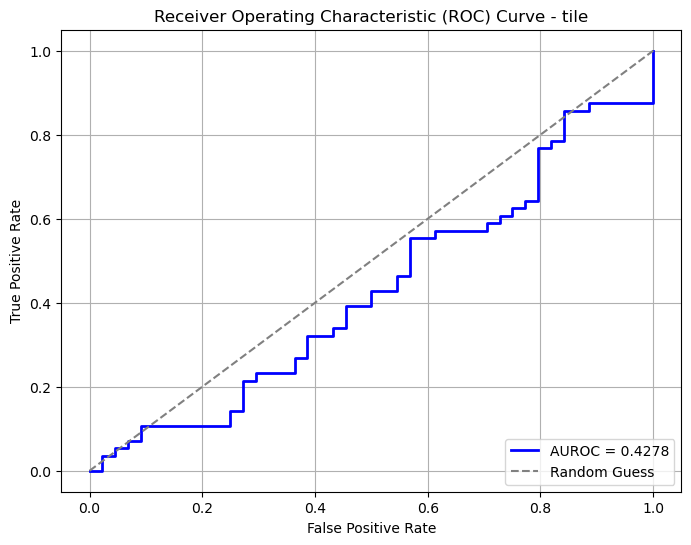

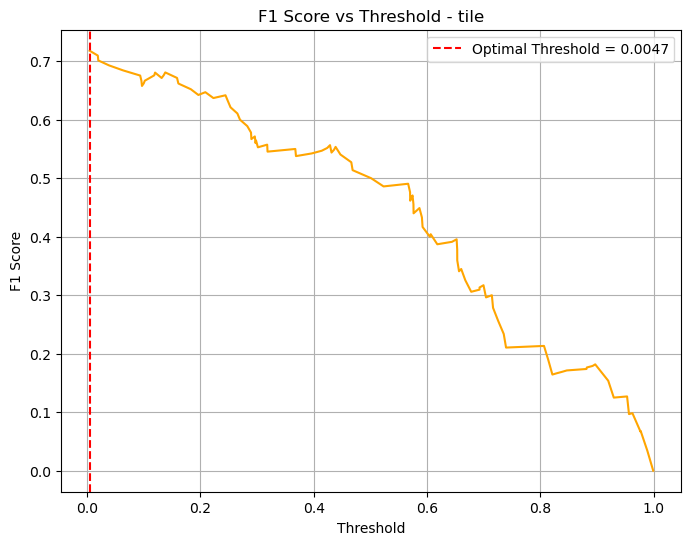

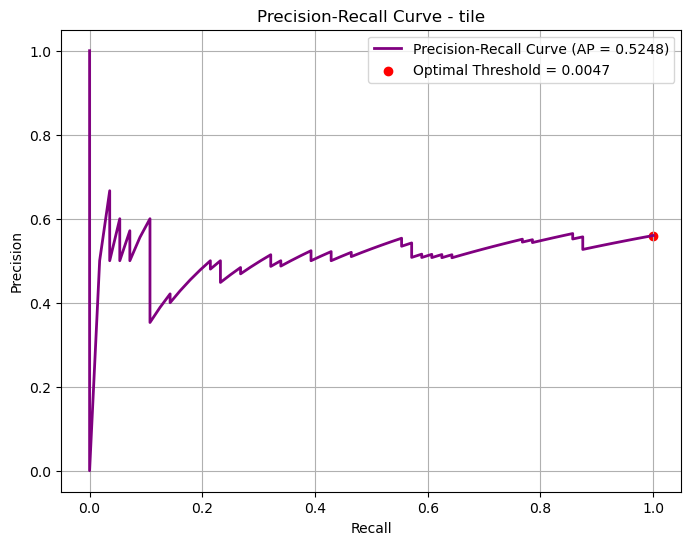

Starting to plot metrics for category 'leather'...


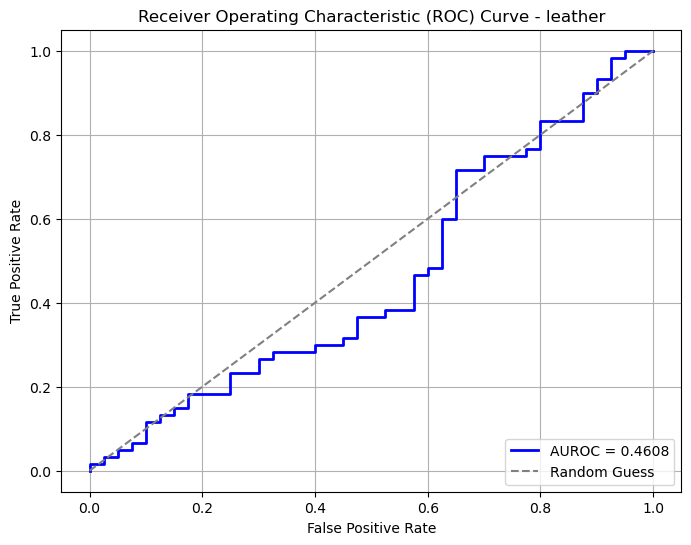

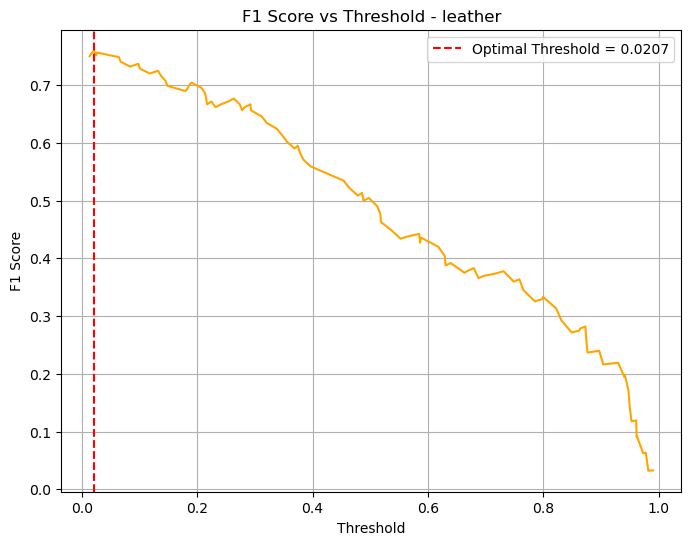

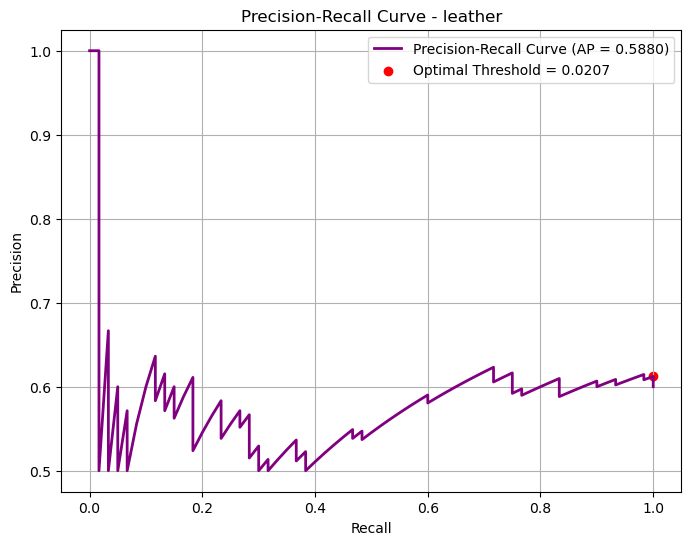

Starting to plot metrics for category 'grid'...


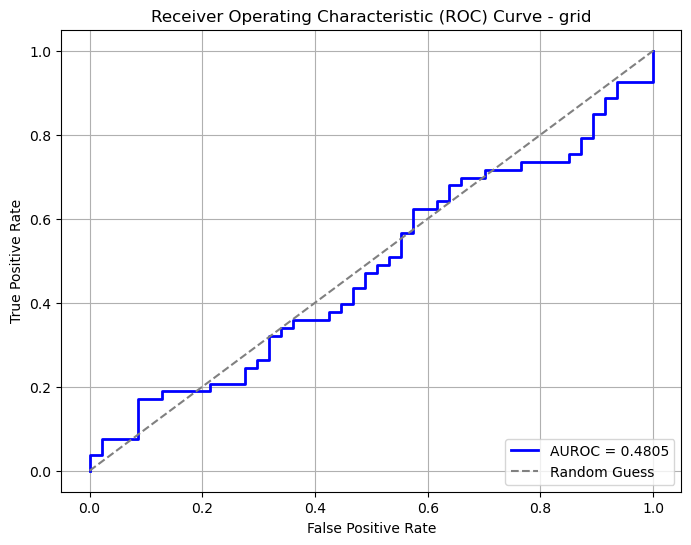

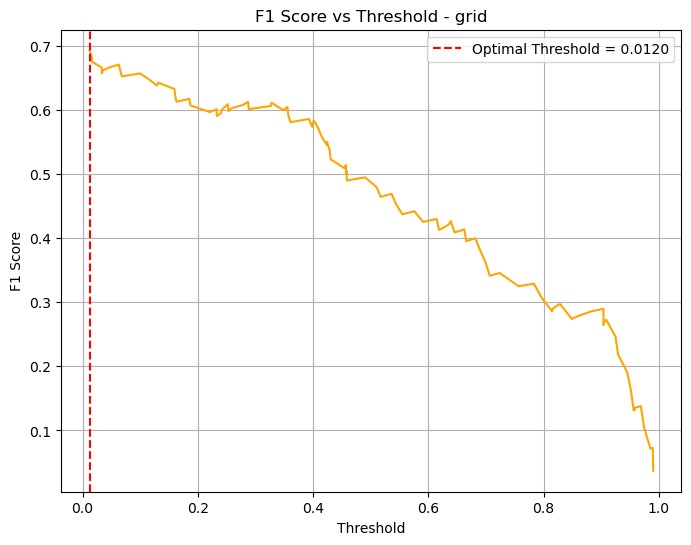

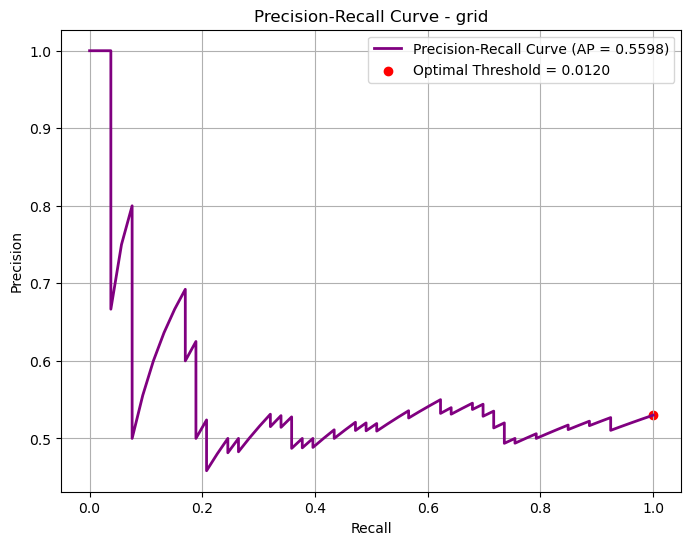

In [48]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

# Simulated data for demonstration (replace with actual data)
np.random.seed(0)
categories = ["tile", "leather", "grid"]
category_data = {
    "tile": (np.random.randint(0, 2, 100), np.random.rand(100)),
    "leather": (np.random.randint(0, 2, 100), np.random.rand(100)),
    "grid": (np.random.randint(0, 2, 100), np.random.rand(100)),
}

def plot_metrics(true_labels, predicted_scores, category_name=""):
    print(f"Starting to plot metrics for category '{category_name}'...")
    
    # Plot ROC Curve
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    auroc = roc_auc_score(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'Receiver Operating Characteristic (ROC) Curve - {category_name}')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    plt.close()  # Close the figure to release memory

    # Calculate Precision-Recall Curve
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

    # Find optimal threshold
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]

    # Plot F1 Score vs Threshold
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
    plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Threshold - {category_name}')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()
    plt.close()  # Close the figure to release memory

    # Plot Precision-Recall Curve
    ap_score = average_precision_score(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {ap_score:.4f})')
    plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title(f'Precision-Recall Curve - {category_name}')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()
    plt.close()  # Close the figure to release memory

# Plot metrics for each category using the simulated data
for category, (true_labels, predicted_scores) in category_data.items():
    plot_metrics(true_labels, predicted_scores, category_name=category)


# Tile (Showing the similarity)

In [13]:
# Import the required modules
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from sklearn.metrics import roc_auc_score, roc_curve
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
dataset_path = "/Users/namanlimani/Downloads/archive"
checkpoint_path = "/Users/namanlimani/Documents/Assignment2b"  # Currently no checkpoint is available

# Initialize the datamodule, model, and engine
datamodule = MVTec(root=dataset_path, train_batch_size=1, category="tile")  # Adjust categories as needed
model = EfficientAd()
engine = Engine(max_epochs=5)

# Train the model (without checkpoint as it's not available)
engine.fit(datamodule=datamodule, model=model)

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0    

Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]python(58708) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58709) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58710) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58711) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58712) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58713) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58714) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(58715) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is depre

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]python(59082) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59083) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59084) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59085) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59086) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59087) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59088) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59089) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is depre

In [15]:
import torch
import torchvision.transforms as transforms
import warnings
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Define ImageNet normalization (if needed for batch_imagenet)
imagenet_normalization = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)

# --------------------- Evaluation and Metrics Computation ---------------------

# Evaluate the model on the test set
print("Evaluating the model on the test set...")
engine.test(datamodule=datamodule, model=model)
print("Evaluation completed.\n")

# Initialize lists to collect true labels and predicted anomaly scores
true_labels = []
predicted_scores = []

# Set model to evaluation mode
model.eval()

# Disable gradient calculations for inference
with torch.no_grad():
    # Loop over the test dataset to gather labels and anomaly scores
    for batch_idx, batch in enumerate(datamodule.test_dataloader()):
        try:
            images = batch['image'].to(model.device)
            labels = batch['label'].cpu().numpy()
            true_labels.extend(labels)

            # Prepare batch_imagenet with ImageNet normalization
            batch_imagenet = imagenet_normalization(images)

            # Forward pass through the model to get predictions
            outputs = model(batch=images, batch_imagenet=batch_imagenet, normalize=True)
            
            if 'anomaly_map' not in outputs:
                raise KeyError("Model output does not contain 'anomaly_map'.")

            # Aggregate anomaly scores
            anomaly_scores = outputs['anomaly_map'].cpu().numpy().mean(axis=(1, 2, 3))
            predicted_scores.extend(anomaly_scores)
            
            print(f"Processed batch {batch_idx + 1} successfully.\n")
        
        except Exception as e:
            print(f"Error processing batch {batch_idx + 1}: {e}\n")
            continue

# Convert lists to numpy arrays for processing
true_labels = np.array(true_labels).flatten()
predicted_scores = np.array(predicted_scores).flatten()

# Debugging: Inspect unique classes in true_labels
unique_classes = np.unique(true_labels)
print(f"Number of unique classes in true_labels: {len(unique_classes)}")
print(f"Unique classes in true_labels: {unique_classes}")

# Ensure binary classification
if len(unique_classes) != 2:
    raise ValueError(f"Expected binary classification, but found {len(unique_classes)} classes: {unique_classes}")
else:
    print("\nConfirmed binary classification with classes:", unique_classes)

# Compute AUROC
try:
    auroc = roc_auc_score(true_labels, predicted_scores)
    print(f"\nAUROC Score: {auroc:.4f}")
except ValueError as e:
    print(f"Error computing ROC AUC Score: {e}")

# Plot ROC Curve
try:
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
except Exception as e:
    print(f"Error plotting ROC Curve: {e}")

# Threshold Analysis
threshold = 0.5
predicted_labels = (predicted_scores > threshold).astype(int)
f1 = f1_score(true_labels, predicted_labels)
print(f"F1 Score with threshold {threshold}: {f1:.4f}")

# Confusion Matrix at threshold 0.5
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix at Threshold 0.5:")
print(conf_matrix)
print("\nConfusion Matrix Breakdown:")
print(f"True Negatives: {conf_matrix[0,0]}")
print(f"False Positives: {conf_matrix[0,1]}")
print(f"False Negatives: {conf_matrix[1,0]}")
print(f"True Positives: {conf_matrix[1,1]}")

# Optimal Threshold Calculation
precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds_pr[optimal_idx]
max_f1 = f1_scores[optimal_idx]

print(f"\nOptimal Threshold based on Precision-Recall Curve: {optimal_threshold:.4f}")
print(f"Maximum F1 Score: {max_f1:.4f}")

# Apply optimal threshold
predicted_labels_optimal = (predicted_scores > optimal_threshold).astype(int)

# Recompute F1 Score at optimal threshold
f1_optimal = f1_score(true_labels, predicted_labels_optimal)
print(f"F1 Score with Optimal Threshold ({optimal_threshold:.4f}): {f1_optimal:.4f}")

# Confusion Matrix at optimal threshold
conf_matrix_optimal = confusion_matrix(true_labels, predicted_labels_optimal)
print("\nConfusion Matrix at Optimal Threshold:")
print(conf_matrix_optimal)
print("\nConfusion Matrix Breakdown at Optimal Threshold:")
print(f"True Negatives: {conf_matrix_optimal[0,0]}")
print(f"False Positives: {conf_matrix_optimal[0,1]}")
print(f"False Negatives: {conf_matrix_optimal[1,0]}")
print(f"True Positives: {conf_matrix_optimal[1,1]}")

# Plot F1 Score vs Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs Threshold')
plt.legend(loc="best")
plt.grid(True)
plt.show()

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()


F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead


Evaluating the model on the test set...


python(59437) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59438) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59439) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59440) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59441) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59442) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59443) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59444) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9816017746925354     │
│       image_F1Score       │    0.9523809552192688     │
│        pixel_AUROC        │    0.8213700652122498     │
│       pixel_F1Score       │    0.5721948742866516     │
└───────────────────────────┴───────────────────────────┘

Evaluation completed.



python(59673) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59674) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59675) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59676) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59677) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59678) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59679) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(59680) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
 

Processed batch 1 successfully.

Processed batch 2 successfully.

Processed batch 3 successfully.

Processed batch 4 successfully.

Number of unique classes in true_labels: 2
Unique classes in true_labels: [0 1]

Confirmed binary classification with classes: [0 1]

AUROC Score: 0.8366
F1 Score with threshold 0.5: 0.0000

Confusion Matrix at Threshold 0.5:
[[33  0]
 [84  0]]

Confusion Matrix Breakdown:
True Negatives: 33
False Positives: 0
False Negatives: 84
True Positives: 0

Optimal Threshold based on Precision-Recall Curve: -0.1414
Maximum F1 Score: 0.8737
F1 Score with Optimal Threshold (-0.1414): 0.8677

Confusion Matrix at Optimal Threshold:
[[10 23]
 [ 2 82]]

Confusion Matrix Breakdown at Optimal Threshold:
True Negatives: 10
False Positives: 23
False Negatives: 2
True Positives: 82


In [39]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

def plot_metrics(true_labels, predicted_scores):
    print("Starting to plot metrics...")  # Debugging line
    
    # Plot ROC Curve
    try:
        fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {roc_auc_score(true_labels, predicted_scores):.4f}')
        plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic (ROC) Curve')
        plt.legend(loc="lower right")
        plt.grid(True)
        plt.show()
    except Exception as e:
        print(f"Error plotting ROC Curve: {e}")

    # Calculate Precision-Recall Curve
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

    # Find optimal threshold
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]
    
    # Debugging print statements for thresholds and F1 score
    print(f"Optimal Threshold: {optimal_threshold}")
    print(f"Maximum F1 Score: {max_f1}")

    # Plot F1 Score vs Threshold
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
    plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title('F1 Score vs Threshold')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()

    # Plot Precision-Recall Curve
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
    plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()

    print("Finished plotting metrics.")  # Debugging line


Starting to plot metrics...


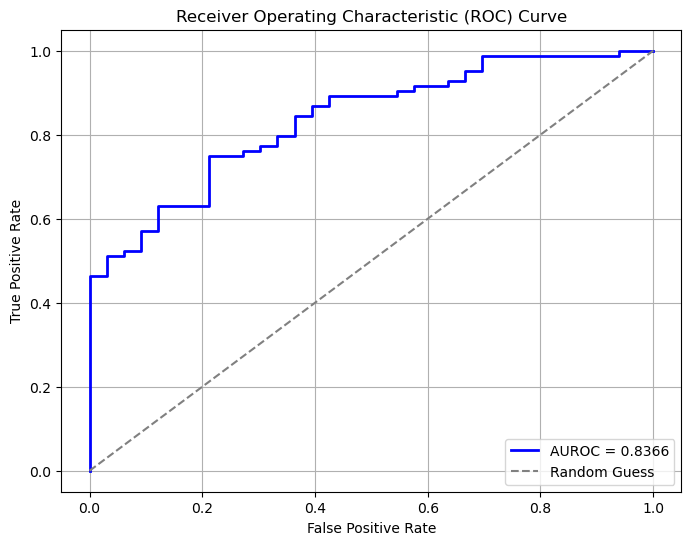

Optimal Threshold: -0.14135341346263885
Maximum F1 Score: 0.8736842055933519


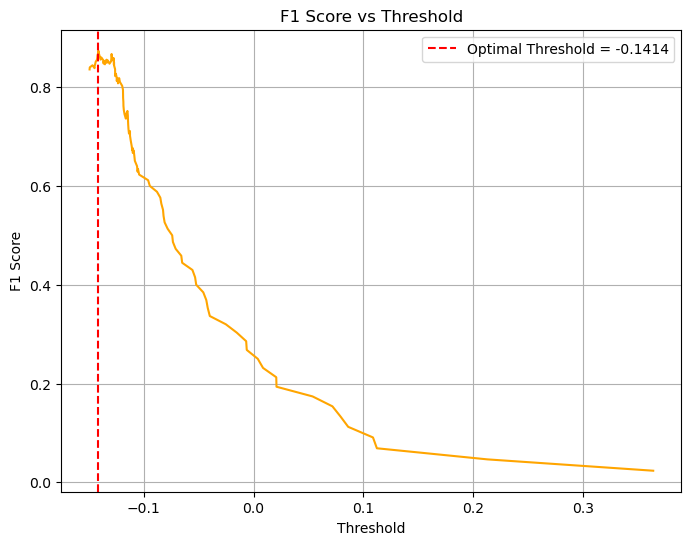

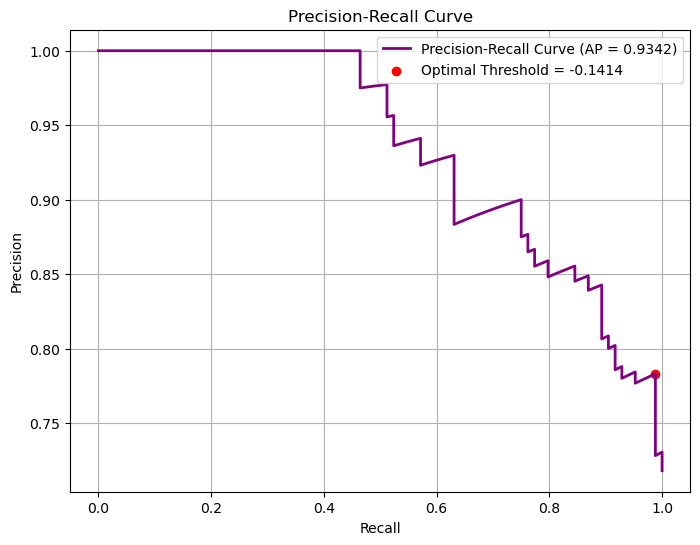

Finished plotting metrics.


In [41]:
# Ensure you only call this once
plot_metrics(true_labels, predicted_scores)


# This code performs an image similarity search within a given dataset. It identifies the top 5 most similar images in a training set for each test image, based on cosine similarity between image feature vectors. The `extract_features` function begins by preprocessing the training images: it converts each image to grayscale, resizes it to a 64x64 pixel array, flattens the array into a 1D feature vector, and stores this vector along with the image path for later comparison.

# The `find_similar_images_for_directory` function then iterates over the test images, following the same preprocessing steps to create feature vectors for each test image. For each test image, it calculates the cosine similarity between its feature vector and those of all training images. The top 5 most similar training images, based on similarity scores, are identified and stored in a dictionary, with each test image path as the key and its top 5 similar images as values.

# Finally, `display_similar_images` visually displays each test image alongside its 5 most similar images using Matplotlib. For each test image, it displays the original image on the left, followed by the 5 similar images to its right, all in grayscale. This layout allows the user to easily compare the test image with visually similar images from the training set. If no similar images are found, the function outputs a message stating so. This code is useful for applications that need simple similarity matching without deep learning, using cosine similarity on flattened grayscale image arrays instead.

Extracted features from 230 training images.
Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/002.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/048.png


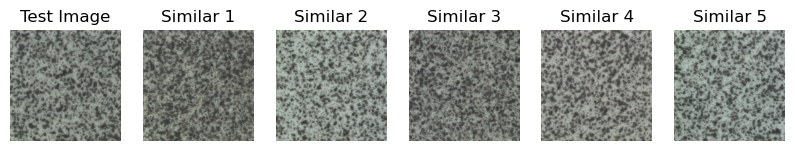

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/016.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/121.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/138.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png


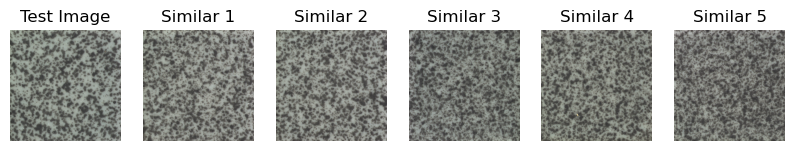

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/017.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/045.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/116.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/121.png


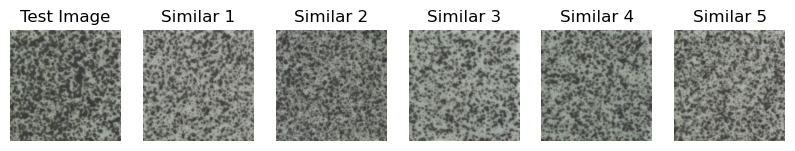

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/003.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/142.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png


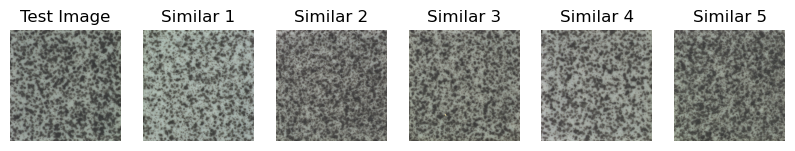

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/029.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png


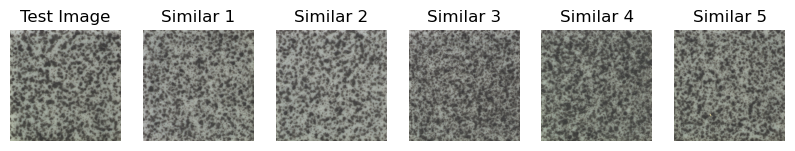

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/015.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/160.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png


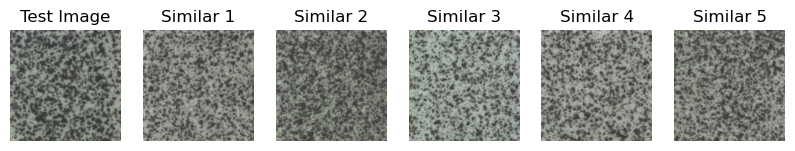

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/001.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/149.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/056.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/191.png


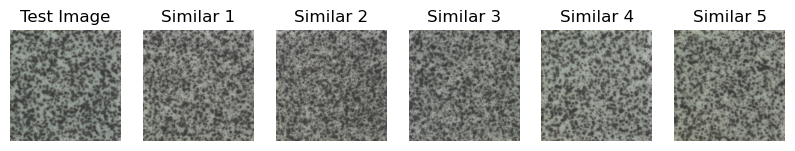

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/000.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/164.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png


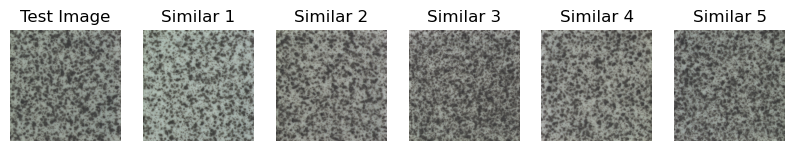

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/014.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/056.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/017.png


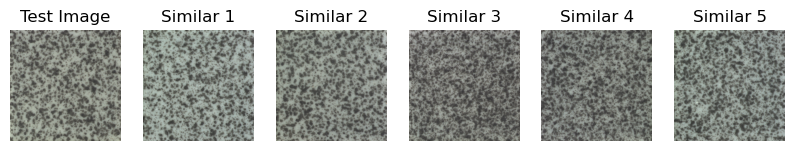

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/028.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/007.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/208.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/116.png


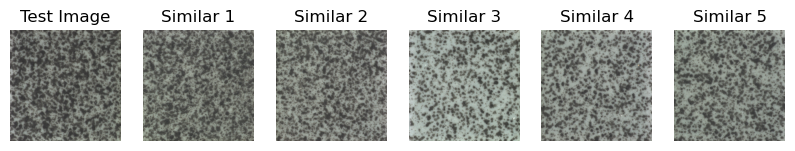

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/010.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/017.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png


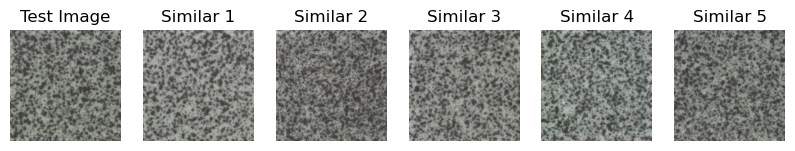

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/004.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png


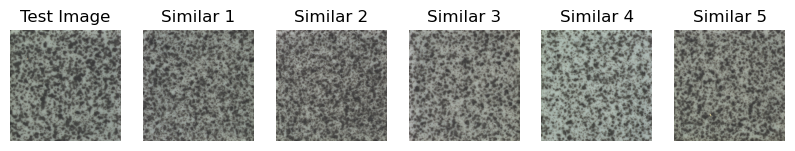

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/005.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/056.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/007.png


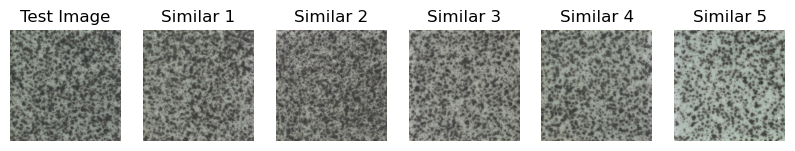

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/011.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/149.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/017.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/045.png


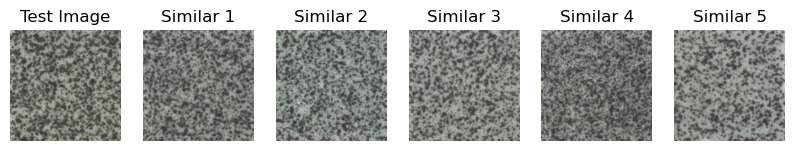

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/007.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/115.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png


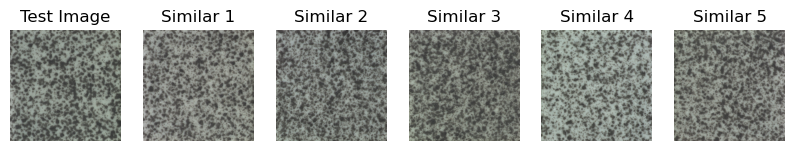

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/013.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/115.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png


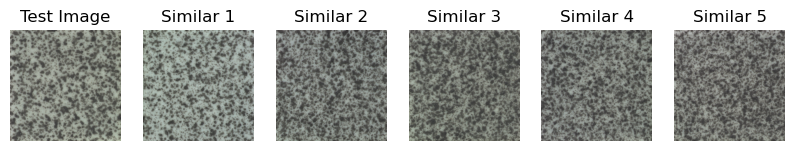

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/012.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/164.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/048.png


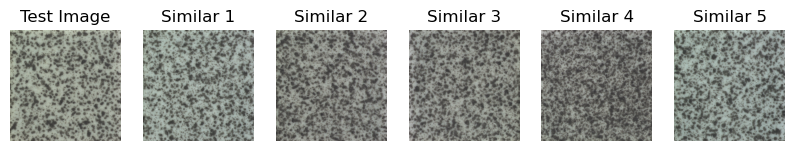

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/006.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/191.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png


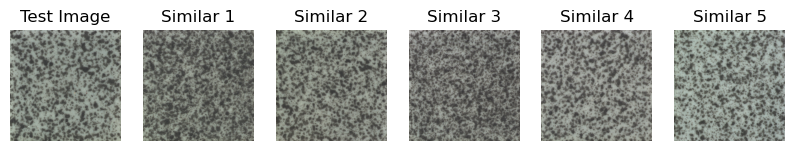

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/023.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/048.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/121.png


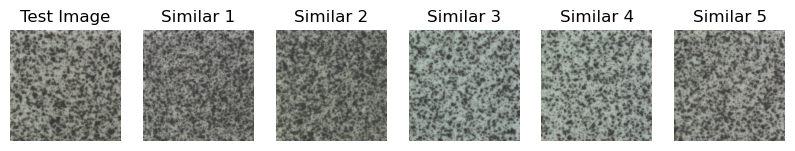

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/022.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/164.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png


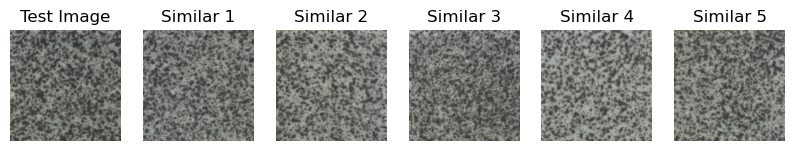

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/008.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/055.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png


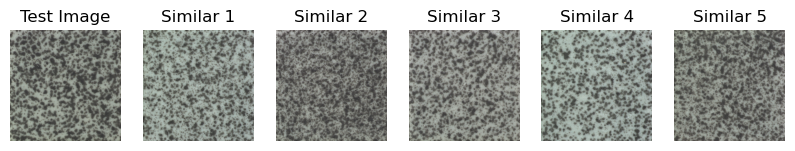

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/020.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png


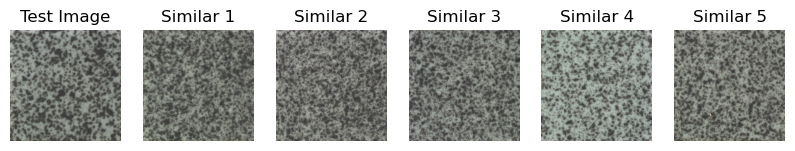

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/021.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/164.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/056.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png


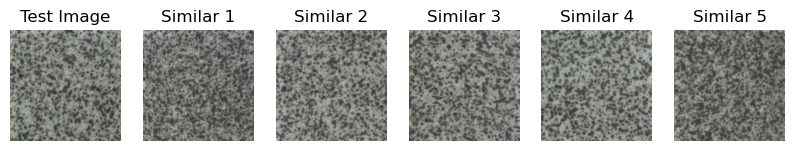

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/009.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/115.png


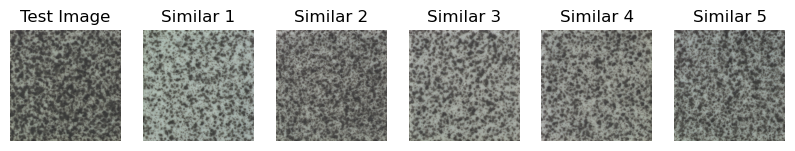

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/031.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/056.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/121.png


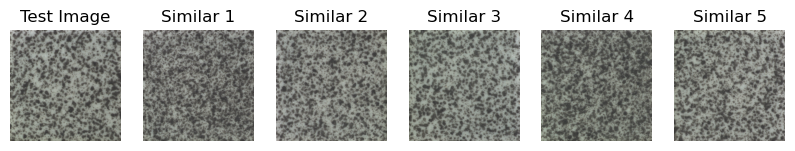

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/025.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/164.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/111.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/126.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/149.png


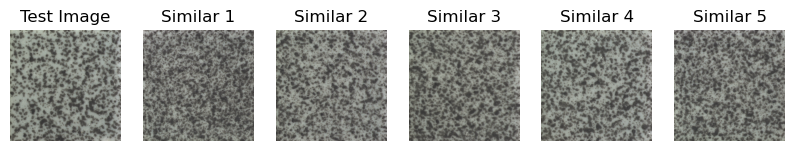

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/019.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/191.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png


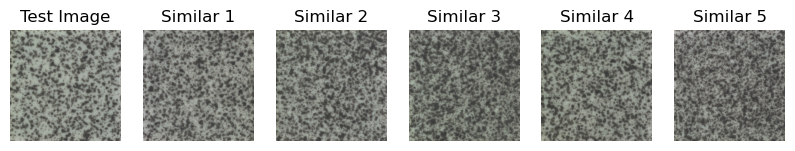

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/018.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/136.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/004.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/133.png


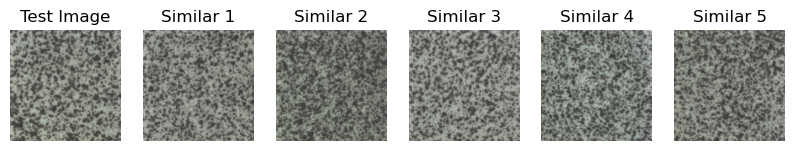

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/024.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/056.png


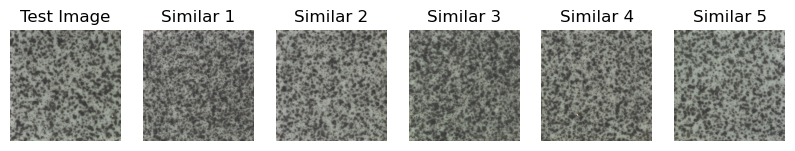

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/030.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/149.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png


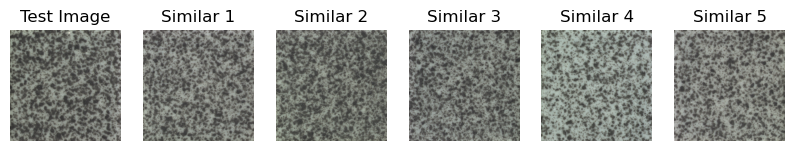

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/026.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/116.png


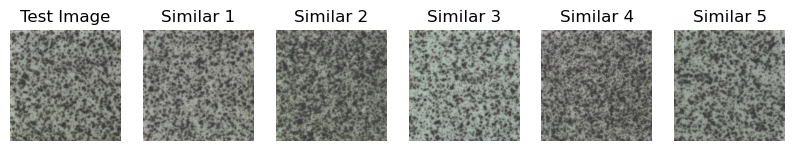

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/032.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/126.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/163.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/164.png


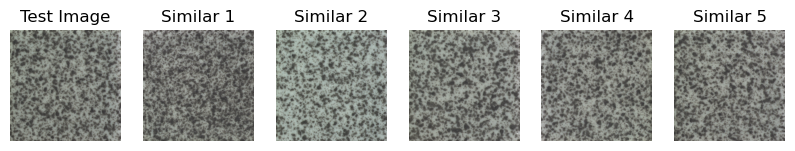

Test Image: /Users/namanlimani/Downloads/archive/tile/test/good/027.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/tile/train/good/201.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/137.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/078.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/170.png
 - /Users/namanlimani/Downloads/archive/tile/train/good/015.png


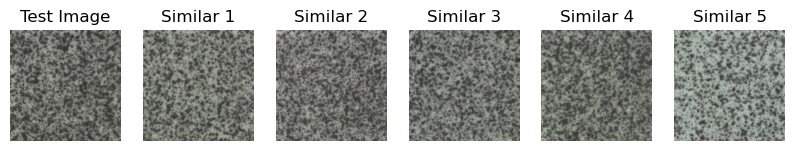

In [19]:
import os
import numpy as np
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

# Define dataset path
dataset_path = "/Users/namanlimani/Downloads/archive/tile"

def extract_features(images_path):
    features = []
    image_files = []
    for img_name in os.listdir(images_path):
        img_path = os.path.join(images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                img = Image.open(img_path).convert("L")
                img_resized = img.resize((64, 64))
                img_array = np.array(img_resized).flatten()
                features.append(img_array)
                image_files.append(img_path)
            except Exception as e:
                print(f"Error processing image {img_path}: {e}")
                continue
    return np.array(features), image_files

def find_similar_images_for_directory(test_images_path, features, image_files, top_n=5):
    test_results = {}
    for img_name in os.listdir(test_images_path):
        img_path = os.path.join(test_images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                input_image = Image.open(img_path).convert("L")
                input_image_resized = input_image.resize((64, 64))
                input_features = np.array(input_image_resized).flatten().reshape(1, -1)
                
                similarities = cosine_similarity(input_features, features).flatten()
                similar_indices = similarities.argsort()[-top_n:][::-1]
                
                similar_images = [image_files[i] for i in similar_indices]
                test_results[img_path] = similar_images
            except Exception as e:
                print(f"Error processing test image {img_path}: {e}")
                continue
    return test_results

def display_similar_images(test_results):
    if not test_results:
        print("No similar images found to display.")
        return
    
    for test_image, similar_images in test_results.items():
        print(f"Test Image: {test_image}")
        print("Top 5 similar images:")
        for img_path in similar_images:
            print(f" - {img_path}")

        # Display the images inline
        plt.figure(figsize=(10, 2))
        
        # Display test image
        test_img = Image.open(test_image)
        plt.subplot(1, 6, 1)
        plt.imshow(test_img, cmap='gray')
        plt.axis('off')
        plt.title("Test Image")
        
        # Display similar images
        for i, img_path in enumerate(similar_images):
            similar_img = Image.open(img_path)
            plt.subplot(1, 6, i + 2)
            plt.imshow(similar_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Similar {i+1}")
        
        plt.show()
        plt.close()

# Load images and extract features from training data
train_images_path = os.path.join(dataset_path, "train/good")
features, image_files = extract_features(train_images_path)
print(f"Extracted features from {len(image_files)} training images.")

# Specify path to test images and display similar images
test_images_path = os.path.join(dataset_path, "test/good")
similar_images_results = find_similar_images_for_directory(test_images_path, features, image_files)
display_similar_images(similar_images_results)


# Leather (showing Similarity)

In [21]:
# Import the required modules
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from sklearn.metrics import roc_auc_score, roc_curve
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
dataset_path = "/Users/namanlimani/Downloads/archive"
checkpoint_path = "/Users/namanlimani/Documents/Assignment2b"  # Currently no checkpoint is available

# Initialize the datamodule, model, and engine
datamodule = MVTec(root=dataset_path, train_batch_size=1, category="leather")  # Adjust categories as needed
model = EfficientAd()
engine = Engine(max_epochs=5)

# Train the model (without checkpoint as it's not available)
engine.fit(datamodule=datamodule, model=model)

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0    

Training: |                                               | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]python(1824) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1825) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1826) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1827) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1828) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1829) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1830) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(1831) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. P

Validation: |                                             | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles:   0%|             | 0/4 [00:00<?, ?it/s]python(2455) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2456) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2457) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2458) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2459) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2460) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2461) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2462) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. P

In [23]:
import torch
import torchvision.transforms as transforms
import warnings
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Define ImageNet normalization (if needed for batch_imagenet)
imagenet_normalization = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)

# --------------------- Evaluation and Metrics Computation ---------------------

# Evaluate the model on the test set
print("Evaluating the model on the test set...")
engine.test(datamodule=datamodule, model=model)
print("Evaluation completed.\n")

# Initialize lists to collect true labels and predicted anomaly scores
true_labels = []
predicted_scores = []

# Set model to evaluation mode
model.eval()

# Disable gradient calculations for inference
with torch.no_grad():
    # Loop over the test dataset to gather labels and anomaly scores
    for batch_idx, batch in enumerate(datamodule.test_dataloader()):
        try:
            images = batch['image'].to(model.device)
            labels = batch['label'].cpu().numpy()
            true_labels.extend(labels)

            # Prepare batch_imagenet with ImageNet normalization
            batch_imagenet = imagenet_normalization(images)

            # Forward pass through the model to get predictions
            outputs = model(batch=images, batch_imagenet=batch_imagenet, normalize=True)
            
            if 'anomaly_map' not in outputs:
                raise KeyError("Model output does not contain 'anomaly_map'.")

            # Aggregate anomaly scores
            anomaly_scores = outputs['anomaly_map'].cpu().numpy().mean(axis=(1, 2, 3))
            predicted_scores.extend(anomaly_scores)
            
            print(f"Processed batch {batch_idx + 1} successfully.\n")
        
        except Exception as e:
            print(f"Error processing batch {batch_idx + 1}: {e}\n")
            continue

# Convert lists to numpy arrays for processing
true_labels = np.array(true_labels).flatten()
predicted_scores = np.array(predicted_scores).flatten()

# Debugging: Inspect unique classes in true_labels
unique_classes = np.unique(true_labels)
print(f"Number of unique classes in true_labels: {len(unique_classes)}")
print(f"Unique classes in true_labels: {unique_classes}")

# Ensure binary classification
if len(unique_classes) != 2:
    raise ValueError(f"Expected binary classification, but found {len(unique_classes)} classes: {unique_classes}")
else:
    print("\nConfirmed binary classification with classes:", unique_classes)

# Compute AUROC
try:
    auroc = roc_auc_score(true_labels, predicted_scores)
    print(f"\nAUROC Score: {auroc:.4f}")
except ValueError as e:
    print(f"Error computing ROC AUC Score: {e}")

# Plot ROC Curve
try:
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
except Exception as e:
    print(f"Error plotting ROC Curve: {e}")

# Threshold Analysis
threshold = 0.5
predicted_labels = (predicted_scores > threshold).astype(int)
f1 = f1_score(true_labels, predicted_labels)
print(f"F1 Score with threshold {threshold}: {f1:.4f}")

# Confusion Matrix at threshold 0.5
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix at Threshold 0.5:")
print(conf_matrix)
print("\nConfusion Matrix Breakdown:")
print(f"True Negatives: {conf_matrix[0,0]}")
print(f"False Positives: {conf_matrix[0,1]}")
print(f"False Negatives: {conf_matrix[1,0]}")
print(f"True Positives: {conf_matrix[1,1]}")

# Optimal Threshold Calculation
precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds_pr[optimal_idx]
max_f1 = f1_scores[optimal_idx]

print(f"\nOptimal Threshold based on Precision-Recall Curve: {optimal_threshold:.4f}")
print(f"Maximum F1 Score: {max_f1:.4f}")

# Apply optimal threshold
predicted_labels_optimal = (predicted_scores > optimal_threshold).astype(int)

# Recompute F1 Score at optimal threshold
f1_optimal = f1_score(true_labels, predicted_labels_optimal)
print(f"F1 Score with Optimal Threshold ({optimal_threshold:.4f}): {f1_optimal:.4f}")

# Confusion Matrix at optimal threshold
conf_matrix_optimal = confusion_matrix(true_labels, predicted_labels_optimal)
print("\nConfusion Matrix at Optimal Threshold:")
print(conf_matrix_optimal)
print("\nConfusion Matrix Breakdown at Optimal Threshold:")
print(f"True Negatives: {conf_matrix_optimal[0,0]}")
print(f"False Positives: {conf_matrix_optimal[0,1]}")
print(f"False Negatives: {conf_matrix_optimal[1,0]}")
print(f"True Positives: {conf_matrix_optimal[1,1]}")

# Plot F1 Score vs Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs Threshold')
plt.legend(loc="best")
plt.grid(True)
plt.show()

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()


F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead


Evaluating the model on the test set...


python(2589) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2590) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2591) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2592) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2593) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2594) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2595) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2596) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │     0.93308424949646      │
│       image_F1Score       │     0.916201114654541     │
│        pixel_AUROC        │    0.9633103609085083     │
│       pixel_F1Score       │    0.5441381931304932     │
└───────────────────────────┴───────────────────────────┘

Evaluation completed.



python(2797) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2798) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2799) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2800) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2801) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2802) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2803) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(2804) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.

Processed batch 1 successfully.

Processed batch 2 successfully.

Processed batch 3 successfully.

Processed batch 4 successfully.

Number of unique classes in true_labels: 2
Unique classes in true_labels: [0 1]

Confirmed binary classification with classes: [0 1]

AUROC Score: 0.5944
F1 Score with threshold 0.5: 0.0000

Confusion Matrix at Threshold 0.5:
[[32  0]
 [92  0]]

Confusion Matrix Breakdown:
True Negatives: 32
False Positives: 0
False Negatives: 92
True Positives: 0

Optimal Threshold based on Precision-Recall Curve: -0.0685
Maximum F1 Score: 0.8519
F1 Score with Optimal Threshold (-0.0685): 0.8465

Confusion Matrix at Optimal Threshold:
[[ 0 32]
 [ 1 91]]

Confusion Matrix Breakdown at Optimal Threshold:
True Negatives: 0
False Positives: 32
False Negatives: 1
True Positives: 91


In [31]:
%matplotlib inline

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

# Initialize a flag to control execution
already_plotted = False

def plot_metrics(true_labels, predicted_scores):
    global already_plotted  # Access the global flag

    # Check if the plots have already been generated
    if already_plotted:
        print("Plots have already been generated. Skipping...")
        return
    else:
        already_plotted = True  # Set the flag to True to prevent re-plotting

    print("Starting to plot metrics...")  # Debugging line
    
    # Plot ROC Curve
    try:
        fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {roc_auc_score(true_labels, predicted_scores):.4f}')
        plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic (ROC) Curve')
        plt.legend(loc="lower right")
        plt.grid(True)
        plt.show()
    except Exception as e:
        print(f"Error plotting ROC Curve: {e}")

    # Calculate Precision-Recall Curve
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

    # Find optimal threshold
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]
    
    # Debugging print statements for thresholds and F1 score
    print(f"Optimal Threshold: {optimal_threshold}")
    print(f"Maximum F1 Score: {max_f1}")

    # Plot F1 Score vs Threshold
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
    plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title('F1 Score vs Threshold')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()

    # Plot Precision-Recall Curve
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
    plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()

    print("Finished plotting metrics.")  # Debugging line


Starting to plot metrics...


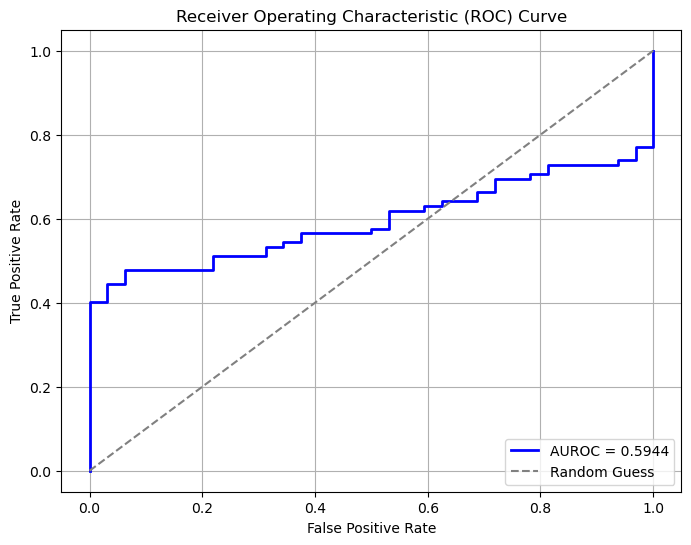

Optimal Threshold: -0.06845059990882874
Maximum F1 Score: 0.8518518469615913


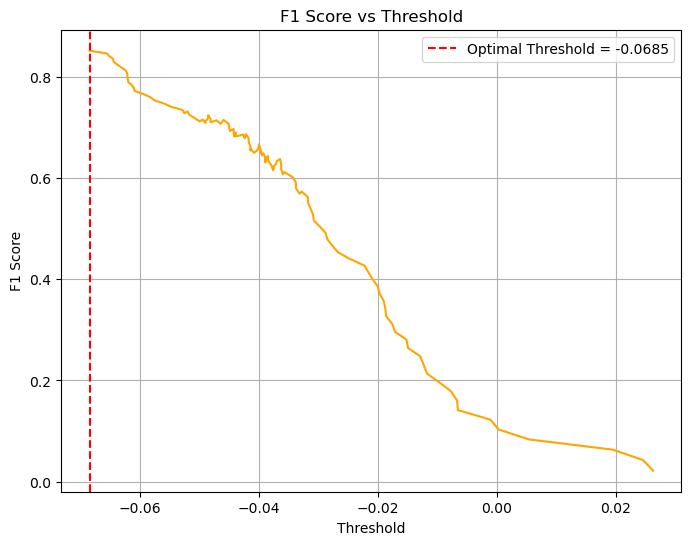

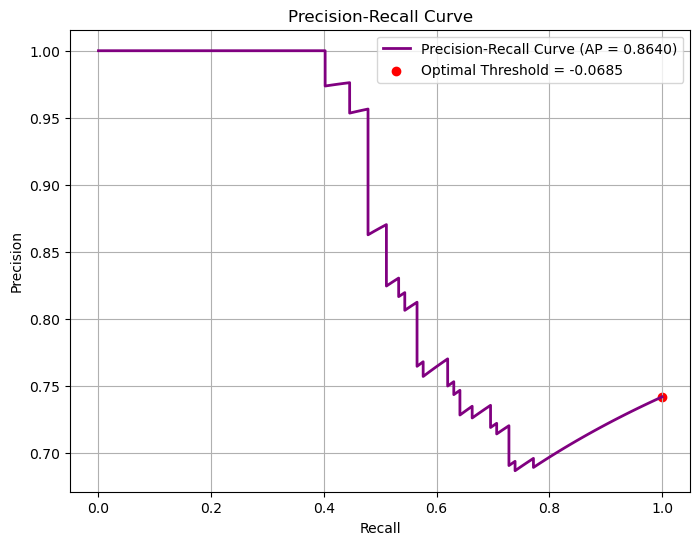

Finished plotting metrics.


In [33]:
# Ensure you only call this once
plot_metrics(true_labels, predicted_scores)


# This code performs image similarity matching by identifying the top 5 most similar images from a training set for each test image in a dataset of leather textures. It begins by defining a dataset path and using the `extract_features` function to process images in the training directory. Each image is converted to grayscale, resized to 64x64 pixels, and flattened into a one-dimensional array of pixel values, which serves as a feature vector for cosine similarity calculations. These feature vectors, along with their corresponding image paths, are stored for later comparison.

# The `find_similar_images_for_directory` function then iterates over the test images in the specified directory. For each test image, it applies the same preprocessing steps to create a feature vector and calculates cosine similarity between this test feature vector and each of the stored training feature vectors. The function identifies the top 5 most similar training images by sorting the similarity scores and selecting the highest scores, excluding the test image itself if it’s part of the training set.

# Finally, the `display_similar_images` function presents the similarity results. For each test image, it displays the image on the left followed by its top 5 most similar images on the right, using Matplotlib. The images are shown in grayscale, labeled sequentially as "Similar 1," "Similar 2," etc., for easy comparison. This function also prints the file paths of the test image and its similar images for reference. This code provides a straightforward approach to image similarity matching by using cosine similarity on grayscale, resized image arrays, allowing for visual inspection of texture similarities within a leather dataset.

Extracted features from 245 training images.

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/002.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/183.png


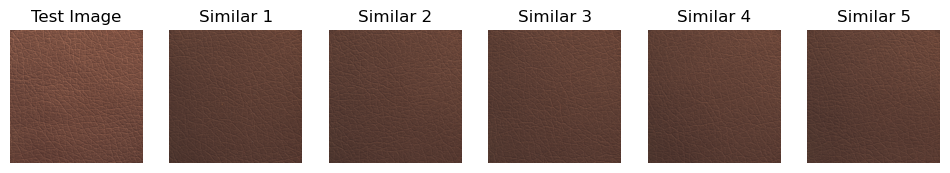


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/016.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png


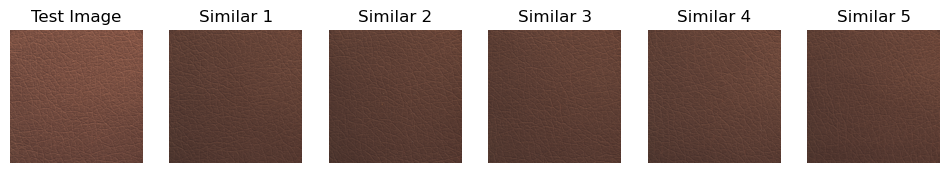


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/017.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/174.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png


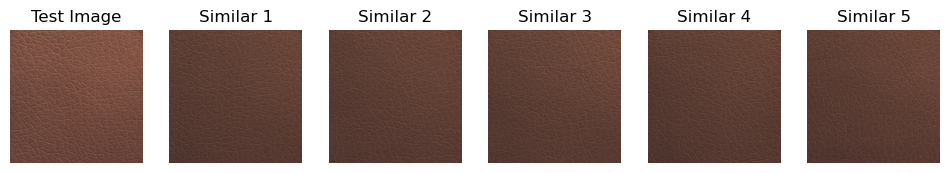


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/003.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/174.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png


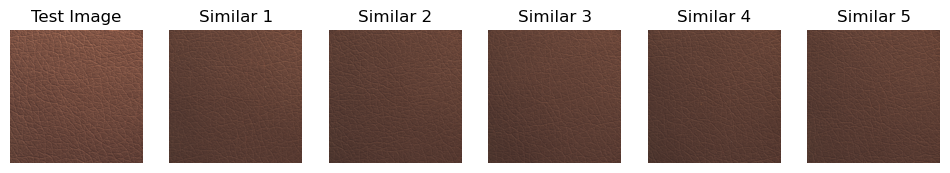


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/029.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/183.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


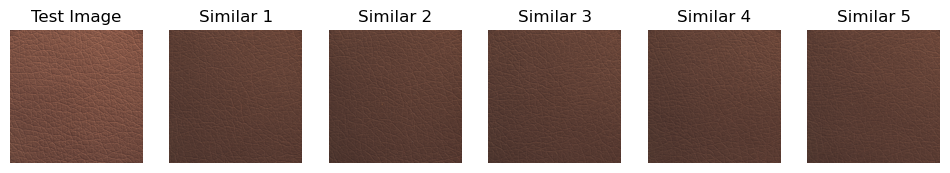


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/015.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


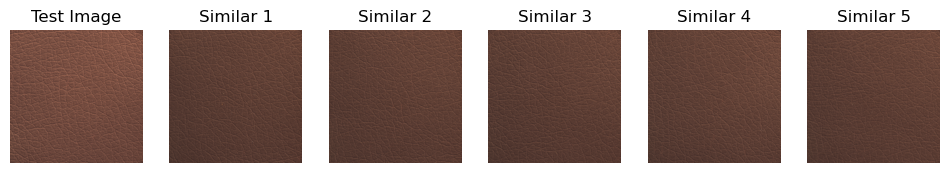


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/001.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/212.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/143.png


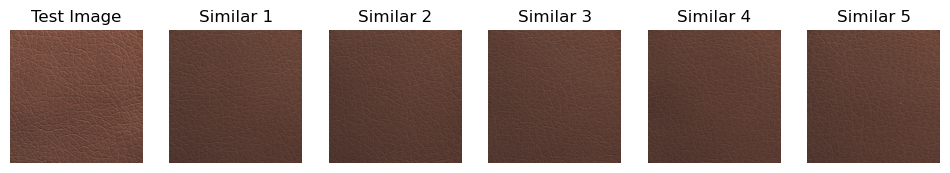


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/000.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/122.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/230.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/076.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/191.png


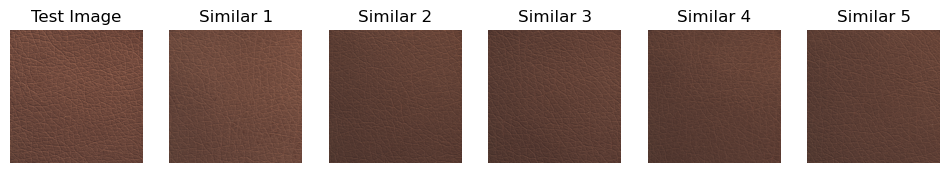


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/014.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png


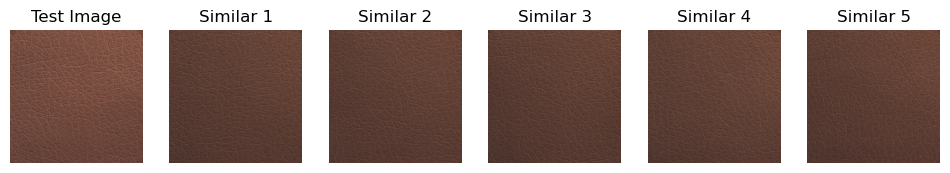


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/028.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


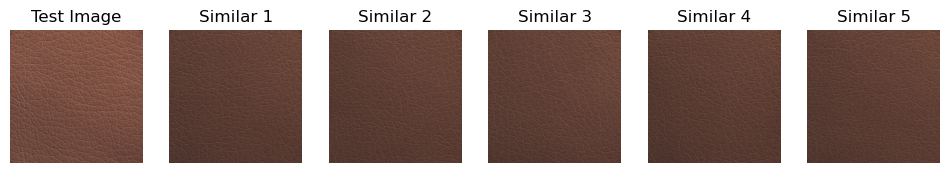


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/010.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


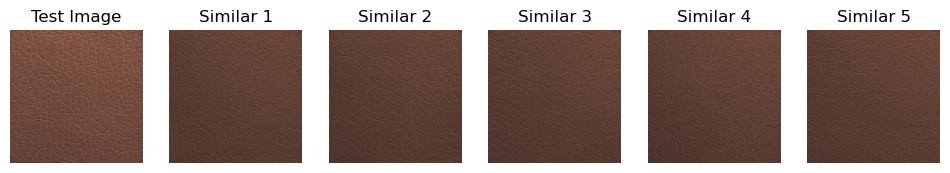


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/004.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/168.png


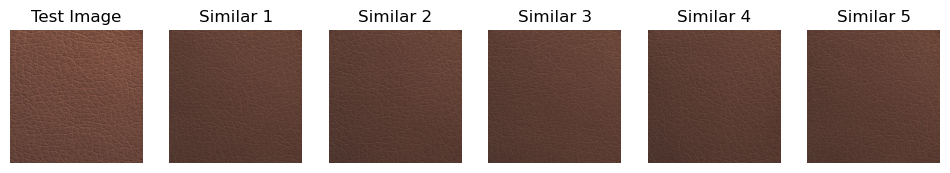


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/005.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/162.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/001.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/183.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/229.png


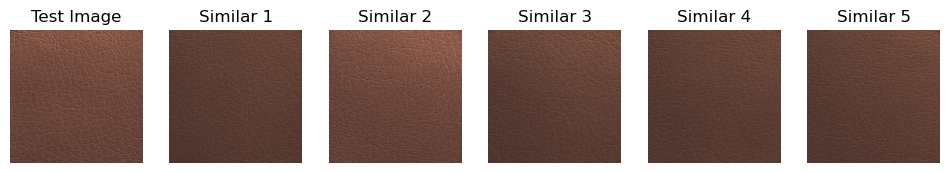


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/011.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/143.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


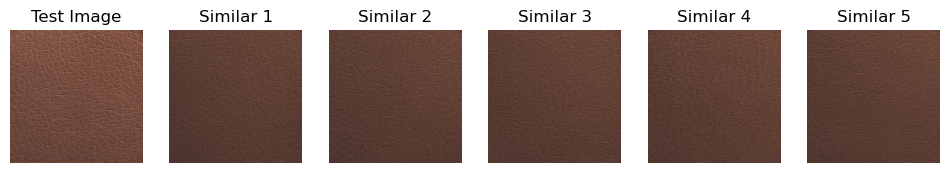


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/007.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/086.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/189.png


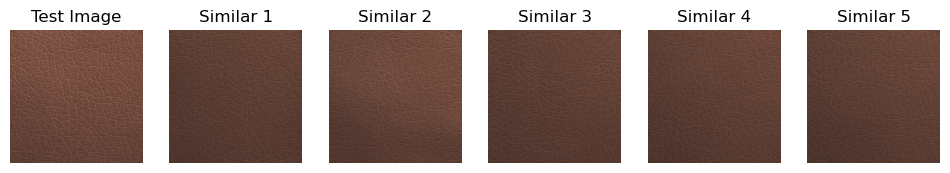


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/013.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/086.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/189.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/001.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png


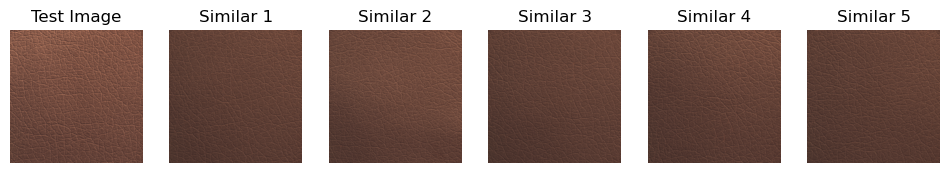


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/012.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/174.png


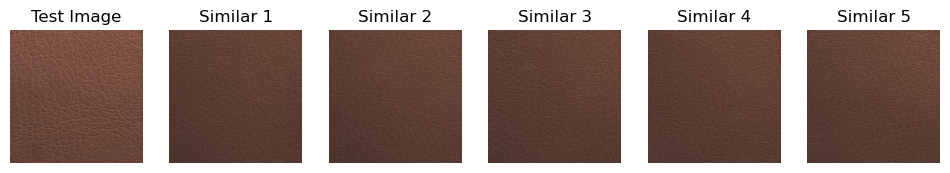


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/006.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png


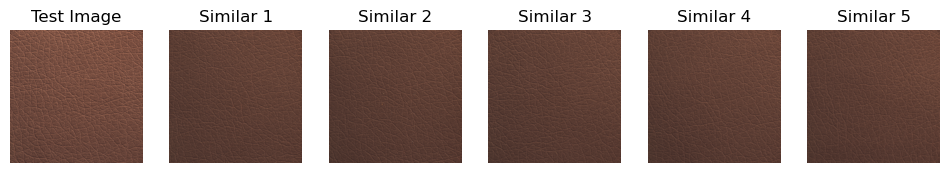


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/023.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/168.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


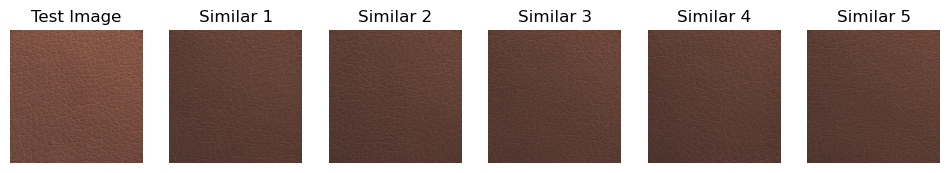


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/022.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/165.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/242.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png


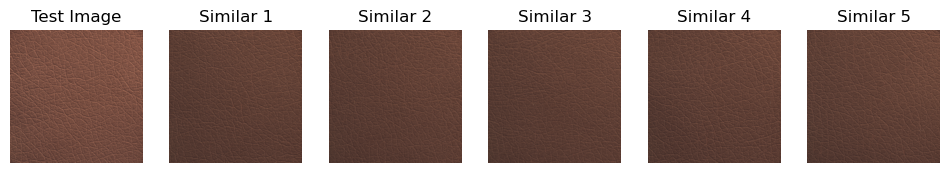


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/008.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


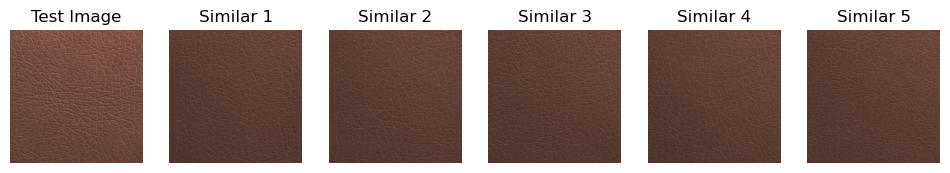


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/020.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png


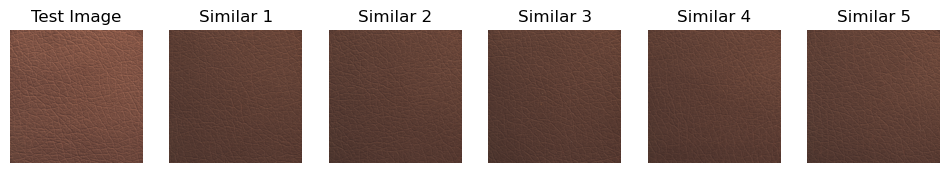


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/021.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/174.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/226.png


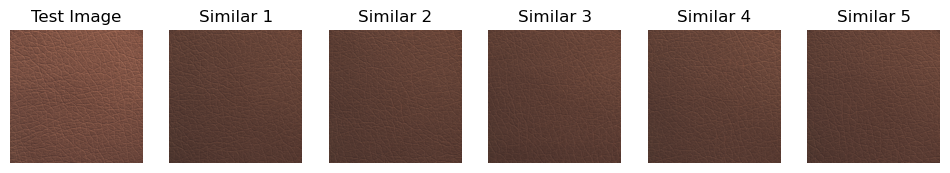


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/009.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/044.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/168.png


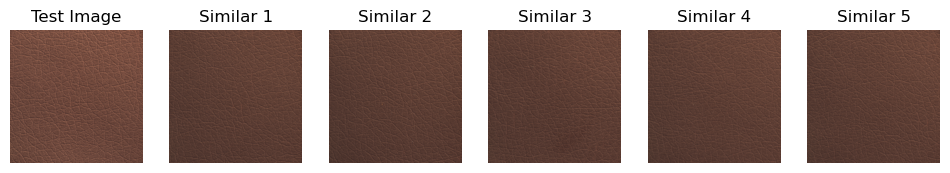


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/031.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png


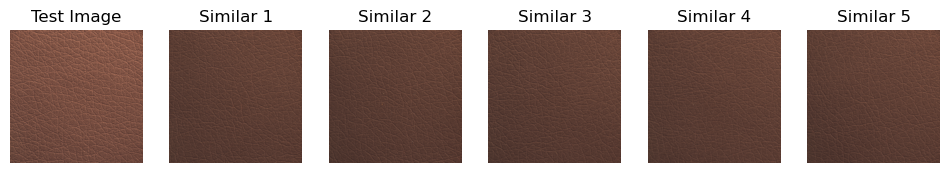


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/025.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/195.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/183.png


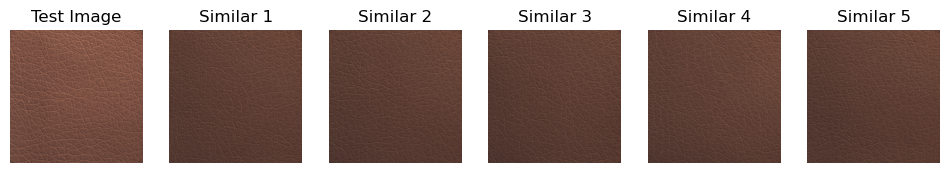


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/019.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/166.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/190.png


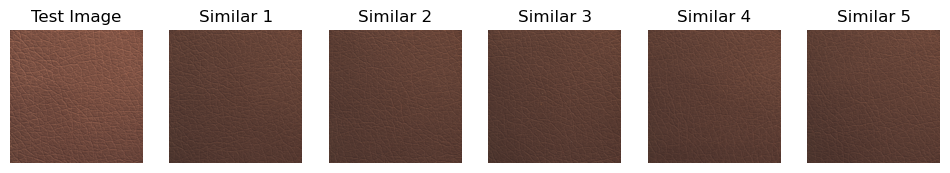


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/018.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/183.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png


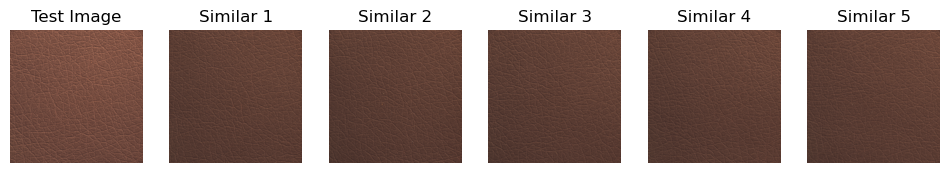


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/024.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/212.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/165.png


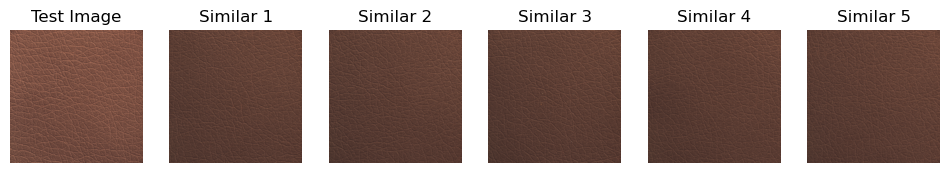


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/030.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/212.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/165.png


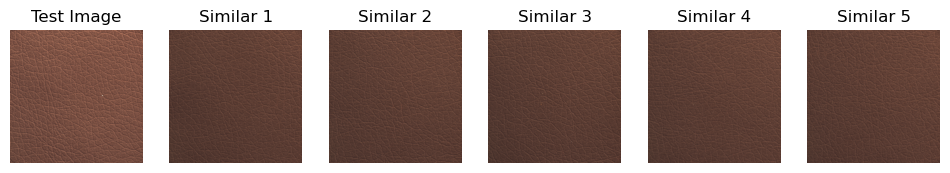


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/026.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/212.png


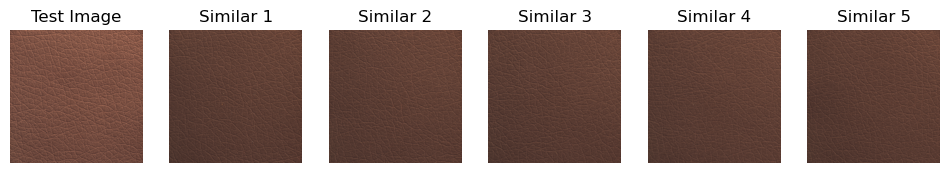


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/leather/test/good/027.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/leather/train/good/193.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/179.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/199.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/109.png
 - /Users/namanlimani/Downloads/archive/leather/train/good/212.png


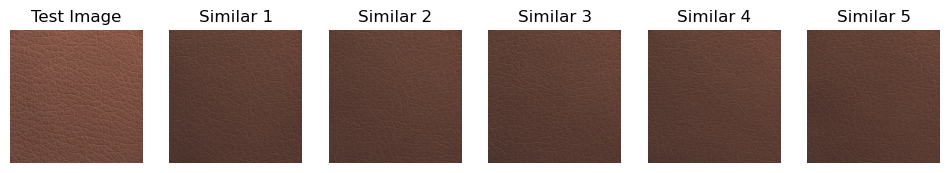


--------------------------------------------------



In [29]:
import os
import numpy as np
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

# Define dataset path
dataset_path = "/Users/namanlimani/Downloads/archive/leather"

def extract_features(images_path):
    features = []
    image_files = []
    for img_name in os.listdir(images_path):
        img_path = os.path.join(images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                img = Image.open(img_path).convert("L")
                img_resized = img.resize((64, 64))
                img_array = np.array(img_resized).flatten()
                features.append(img_array)
                image_files.append(img_path)
            except Exception as e:
                print(f"Error processing image {img_path}: {e}")
                continue
    return np.array(features), image_files

def find_similar_images_for_directory(test_images_path, features, image_files, top_n=5):
    test_results = {}
    for img_name in os.listdir(test_images_path):
        img_path = os.path.join(test_images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                input_image = Image.open(img_path).convert("L")
                input_image_resized = input_image.resize((64, 64))
                input_features = np.array(input_image_resized).flatten().reshape(1, -1)
                
                similarities = cosine_similarity(input_features, features).flatten()
                similar_indices = similarities.argsort()[-top_n:][::-1]
                
                similar_images = [image_files[i] for i in similar_indices]
                test_results[img_path] = similar_images
            except Exception as e:
                print(f"Error processing test image {img_path}: {e}")
                continue
    return test_results

def display_similar_images(test_results):
    if not test_results:
        print("No similar images found to display.")
        return
    
    for test_image, similar_images in test_results.items():
        # Print paths as shown in the screenshot for clarity
        print(f"Test Image: {test_image}")
        print("Top 5 similar images:")
        for img_path in similar_images:
            print(f" - {img_path}")
        
        # Display test and similar images in a row
        plt.figure(figsize=(12, 2))
        
        # Display the test image with label
        test_img = Image.open(test_image)
        plt.subplot(1, 6, 1)
        plt.imshow(test_img, cmap='gray')
        plt.axis('off')
        plt.title("Test Image")
        
        # Display each similar image with labels "Similar 1", "Similar 2", etc.
        for i, img_path in enumerate(similar_images):
            similar_img = Image.open(img_path)
            plt.subplot(1, 6, i + 2)
            plt.imshow(similar_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Similar {i+1}")
        
        plt.show()
        print("\n" + "-" * 50 + "\n")  # Separator for readability

# Load images and extract features from training data
train_images_path = os.path.join(dataset_path, "train/good")
features, image_files = extract_features(train_images_path)
print(f"Extracted features from {len(image_files)} training images.\n")

# Specify path to test images and display similar images
test_images_path = os.path.join(dataset_path, "test/good")
similar_images_results = find_similar_images_for_directory(test_images_path, features, image_files)
display_similar_images(similar_images_results)


# Grid

In [ ]:
# Import the required modules
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from sklearn.metrics import roc_auc_score, roc_curve
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
checkpoint_path = "/Users/namanlimani/Documents/Assignment2b"  # Currently no checkpoint is available

# Initialize the datamodule, model, and engine
datamodule = MVTec(root=dataset_path, train_batch_size=1, category="grid")  # Adjust categories as needed
model = EfficientAd()
engine = Engine(max_epochs=5)

# Train the model (without checkpoint as it's not available)
engine.fit(datamodule=datamodule, model=model)

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
mvtec: 5.26GB [07:52, 11.1MB/s]                                                 
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead

  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollect

Training: |                                               | 0/? [00:00<?, ?it/s]

python(4216) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4217) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4218) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4219) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4220) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4221) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4222) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(4223) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.

In [37]:
import torch
import torchvision.transforms as transforms
import warnings
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Define ImageNet normalization (if needed for batch_imagenet)
imagenet_normalization = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)

# --------------------- Evaluation and Metrics Computation ---------------------

# Evaluate the model on the test set
print("Evaluating the model on the test set...")
engine.test(datamodule=datamodule, model=model)
print("Evaluation completed.\n")

# Initialize lists to collect true labels and predicted anomaly scores
true_labels = []
predicted_scores = []

# Set model to evaluation mode
model.eval()

# Disable gradient calculations for inference
with torch.no_grad():
    # Loop over the test dataset to gather labels and anomaly scores
    for batch_idx, batch in enumerate(datamodule.test_dataloader()):
        try:
            images = batch['image'].to(model.device)
            labels = batch['label'].cpu().numpy()
            true_labels.extend(labels)

            # Prepare batch_imagenet with ImageNet normalization
            batch_imagenet = imagenet_normalization(images)

            # Forward pass through the model to get predictions
            outputs = model(batch=images, batch_imagenet=batch_imagenet, normalize=True)
            
            if 'anomaly_map' not in outputs:
                raise KeyError("Model output does not contain 'anomaly_map'.")

            # Aggregate anomaly scores
            anomaly_scores = outputs['anomaly_map'].cpu().numpy().mean(axis=(1, 2, 3))
            predicted_scores.extend(anomaly_scores)
            
            print(f"Processed batch {batch_idx + 1} successfully.\n")
        
        except Exception as e:
            print(f"Error processing batch {batch_idx + 1}: {e}\n")
            continue

# Convert lists to numpy arrays for processing
true_labels = np.array(true_labels).flatten()
predicted_scores = np.array(predicted_scores).flatten()

# Debugging: Inspect unique classes in true_labels
unique_classes = np.unique(true_labels)
print(f"Number of unique classes in true_labels: {len(unique_classes)}")
print(f"Unique classes in true_labels: {unique_classes}")

# Ensure binary classification
if len(unique_classes) != 2:
    raise ValueError(f"Expected binary classification, but found {len(unique_classes)} classes: {unique_classes}")
else:
    print("\nConfirmed binary classification with classes:", unique_classes)

# Compute AUROC
try:
    auroc = roc_auc_score(true_labels, predicted_scores)
    print(f"\nAUROC Score: {auroc:.4f}")
except ValueError as e:
    print(f"Error computing ROC AUC Score: {e}")

# Plot ROC Curve
try:
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
except Exception as e:
    print(f"Error plotting ROC Curve: {e}")

# Threshold Analysis
threshold = 0.5
predicted_labels = (predicted_scores > threshold).astype(int)
f1 = f1_score(true_labels, predicted_labels)
print(f"F1 Score with threshold {threshold}: {f1:.4f}")

# Confusion Matrix at threshold 0.5
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix at Threshold 0.5:")
print(conf_matrix)
print("\nConfusion Matrix Breakdown:")
print(f"True Negatives: {conf_matrix[0,0]}")
print(f"False Positives: {conf_matrix[0,1]}")
print(f"False Negatives: {conf_matrix[1,0]}")
print(f"True Positives: {conf_matrix[1,1]}")

# Optimal Threshold Calculation
precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds_pr[optimal_idx]
max_f1 = f1_scores[optimal_idx]

print(f"\nOptimal Threshold based on Precision-Recall Curve: {optimal_threshold:.4f}")
print(f"Maximum F1 Score: {max_f1:.4f}")

# Apply optimal threshold
predicted_labels_optimal = (predicted_scores > optimal_threshold).astype(int)

# Recompute F1 Score at optimal threshold
f1_optimal = f1_score(true_labels, predicted_labels_optimal)
print(f"F1 Score with Optimal Threshold ({optimal_threshold:.4f}): {f1_optimal:.4f}")

# Confusion Matrix at optimal threshold
conf_matrix_optimal = confusion_matrix(true_labels, predicted_labels_optimal)
print("\nConfusion Matrix at Optimal Threshold:")
print(conf_matrix_optimal)
print("\nConfusion Matrix Breakdown at Optimal Threshold:")
print(f"True Negatives: {conf_matrix_optimal[0,0]}")
print(f"False Positives: {conf_matrix_optimal[0,1]}")
print(f"False Negatives: {conf_matrix_optimal[1,0]}")
print(f"True Positives: {conf_matrix_optimal[1,1]}")

# Plot F1 Score vs Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs Threshold')
plt.legend(loc="best")
plt.grid(True)
plt.show()

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()


F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead
F1Score class exists for backwards compatibility. It will be removed in v1.1. Please use BinaryF1Score from torchmetrics instead


Evaluating the model on the test set...


python(3563) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3564) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3565) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3566) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3567) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3568) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3569) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3570) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Testing: |                                                | 0/? [00:00<?, ?it/s]

/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., de

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9615706205368042     │
│       image_F1Score       │     0.931034505367279     │
│        pixel_AUROC        │    0.8245892524719238     │
│       pixel_F1Score       │    0.2481801062822342     │
└───────────────────────────┴───────────────────────────┘

Evaluation completed.



python(3695) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3696) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3697) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3698) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3699) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3700) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3701) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(3702) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
/opt/anaconda3/lib/python3.12/site-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.

Processed batch 1 successfully.

Processed batch 2 successfully.

Processed batch 3 successfully.

Number of unique classes in true_labels: 2
Unique classes in true_labels: [0 1]

Confirmed binary classification with classes: [0 1]

AUROC Score: 0.5731
F1 Score with threshold 0.5: 0.0000

Confusion Matrix at Threshold 0.5:
[[21  0]
 [57  0]]

Confusion Matrix Breakdown:
True Negatives: 21
False Positives: 0
False Negatives: 57
True Positives: 0

Optimal Threshold based on Precision-Recall Curve: -0.2628
Maximum F1 Score: 0.8444
F1 Score with Optimal Threshold (-0.2628): 0.8358

Confusion Matrix at Optimal Threshold:
[[ 0 21]
 [ 1 56]]

Confusion Matrix Breakdown at Optimal Threshold:
True Negatives: 0
False Positives: 21
False Negatives: 1
True Positives: 56


In [45]:
%matplotlib inline

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

# Initialize a flag to control execution
already_plotted = False

def plot_metrics(true_labels, predicted_scores):
    global already_plotted  # Access the global flag

    # Check if the plots have already been generated
    if already_plotted:
        print("Plots have already been generated. Skipping...")
        return
    else:
        already_plotted = True  # Set the flag to True to prevent re-plotting

    print("Starting to plot metrics...")  # Debugging line
    
    # Plot ROC Curve
    try:
        fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {roc_auc_score(true_labels, predicted_scores):.4f}')
        plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic (ROC) Curve')
        plt.legend(loc="lower right")
        plt.grid(True)
        plt.show()
    except Exception as e:
        print(f"Error plotting ROC Curve: {e}")

    # Calculate Precision-Recall Curve
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

    # Find optimal threshold
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]
    
    # Debugging print statements for thresholds and F1 score
    print(f"Optimal Threshold: {optimal_threshold}")
    print(f"Maximum F1 Score: {max_f1}")

    # Plot F1 Score vs Threshold
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
    plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title('F1 Score vs Threshold')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()

    # Plot Precision-Recall Curve
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
    plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()

    # Close all figures to prevent lingering plots in memory
    plt.close('all')

    print("Finished plotting metrics.")  # Debugging line


Starting to plot metrics...


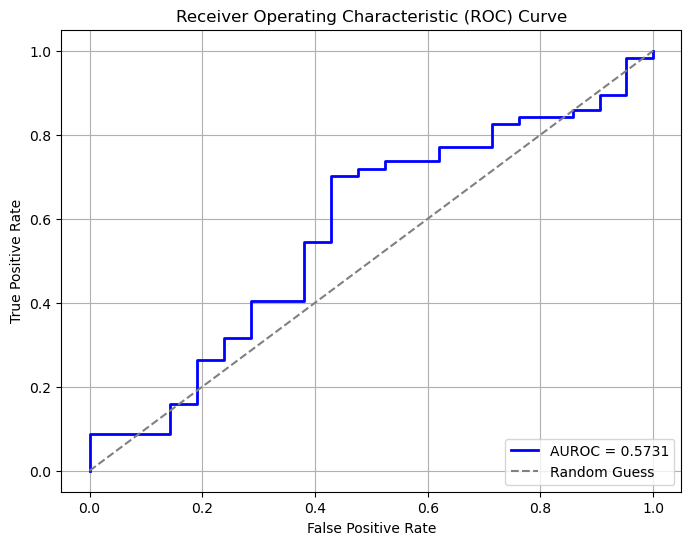

Optimal Threshold: -0.2627911865711212
Maximum F1 Score: 0.844444439565432


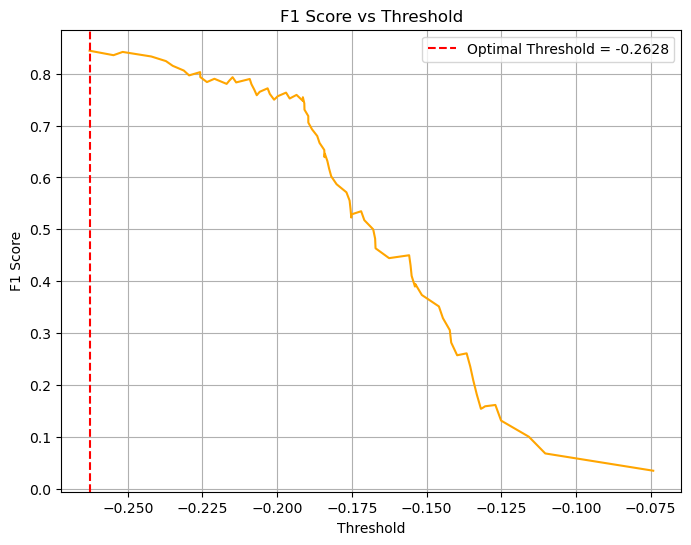

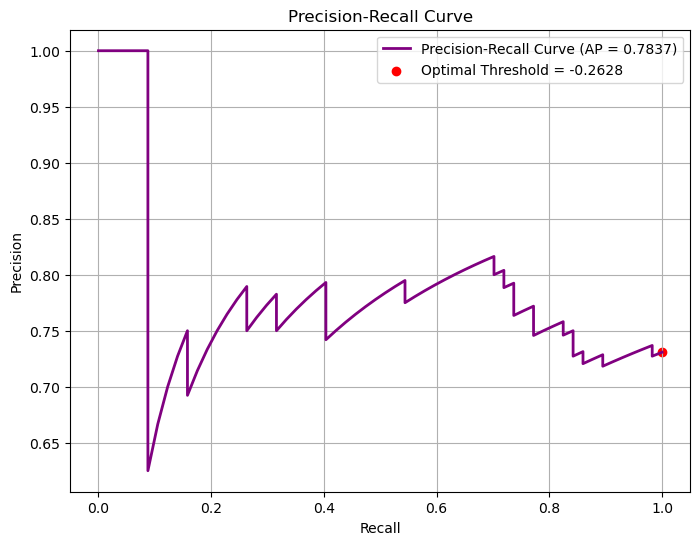

Finished plotting metrics.


In [47]:
# Ensure you only call this once
plot_metrics(true_labels, predicted_scores)

Extracted features from 264 training images.

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/002.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/067.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/025.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/180.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/079.png


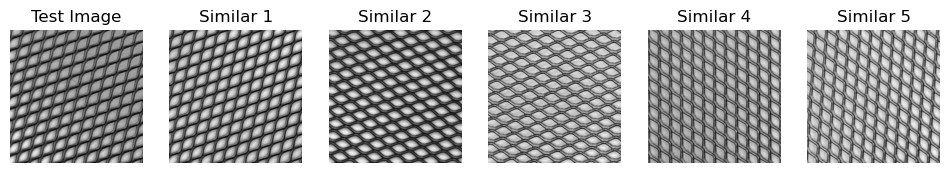


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/016.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/171.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/035.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/137.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/148.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/101.png


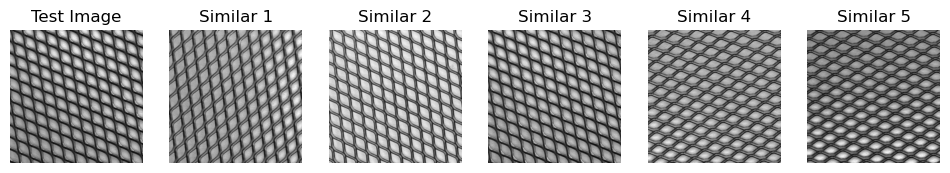


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/017.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/051.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/181.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/067.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/260.png


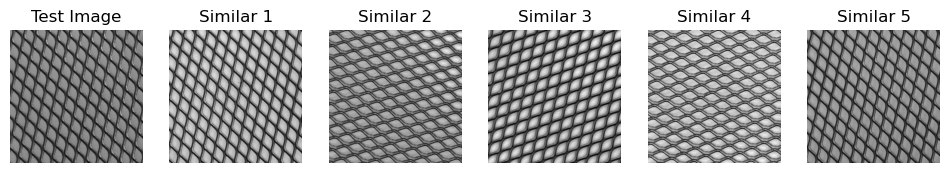


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/003.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/129.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/002.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/230.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/048.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/017.png


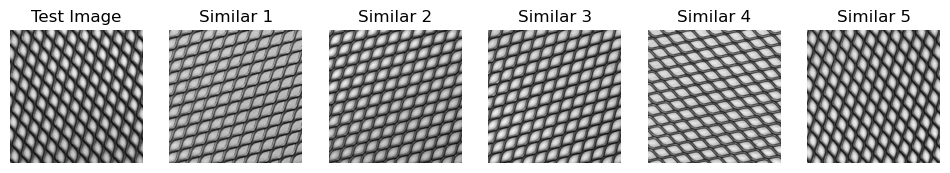


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/015.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/206.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/127.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/144.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/040.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/063.png


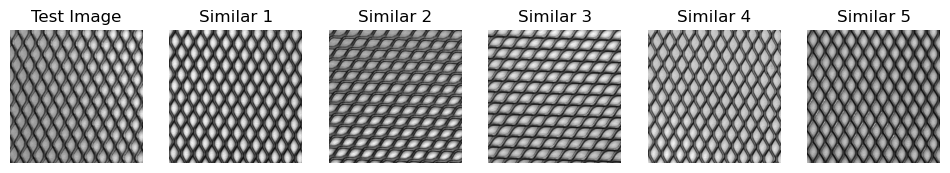


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/001.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/221.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/031.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/049.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/027.png


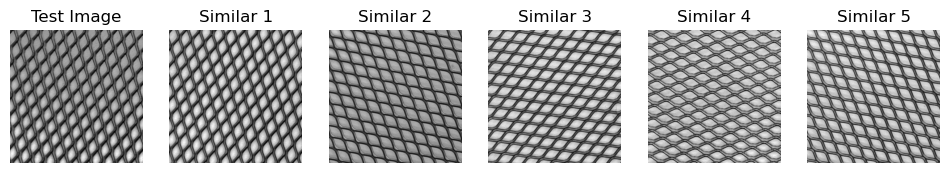


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/000.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/107.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/060.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/210.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/012.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/074.png


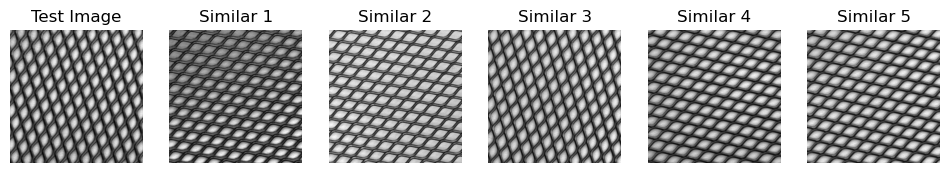


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/014.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/080.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/180.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/120.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/109.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png


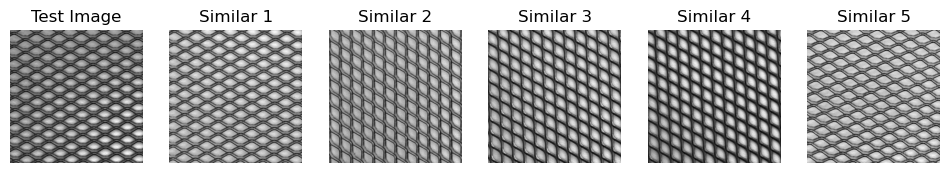


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/010.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/173.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/179.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/133.png


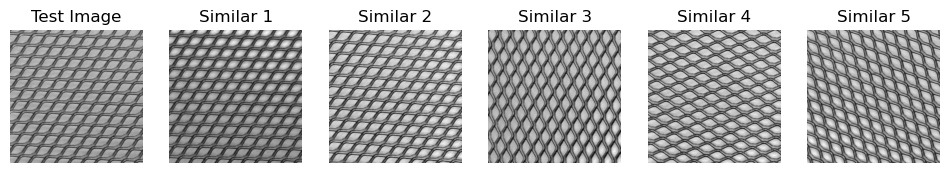


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/004.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/030.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/119.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/133.png


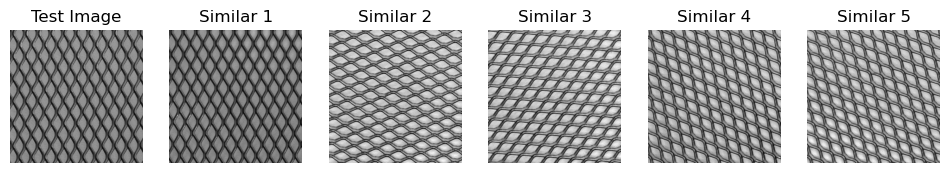


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/005.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/190.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/053.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/062.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/119.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png


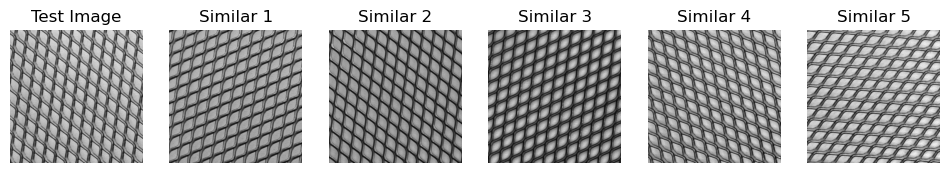


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/011.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/079.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/125.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/133.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/169.png


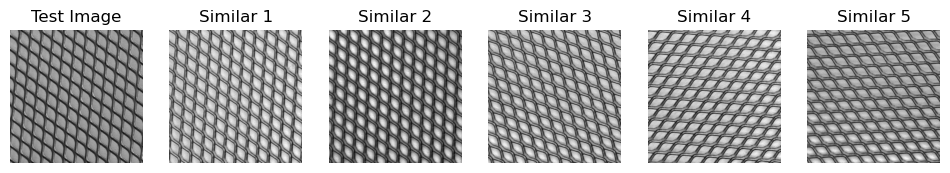


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/007.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/066.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/125.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/215.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/119.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png


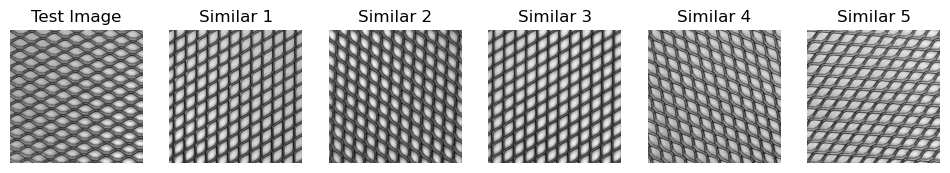


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/013.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/007.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/248.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/168.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/247.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png


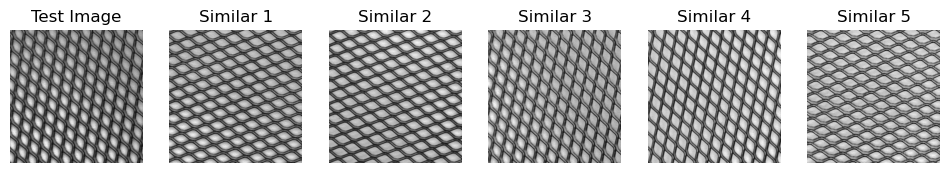


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/012.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/036.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/069.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/072.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/164.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png


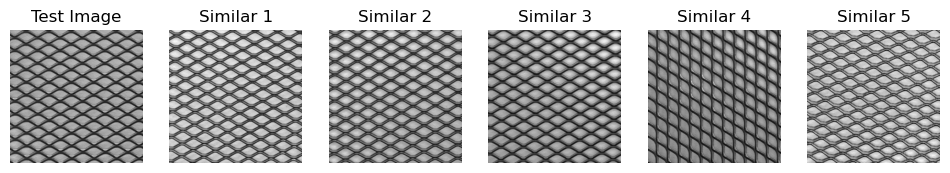


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/006.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/058.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/013.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/057.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png


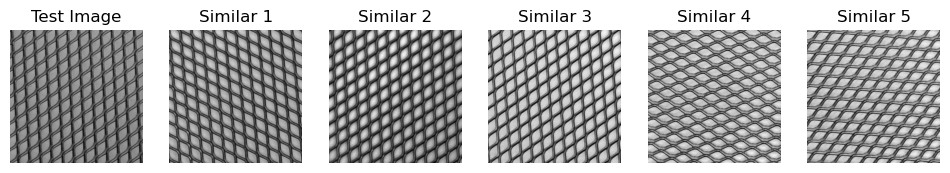


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/008.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/046.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/133.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/119.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/169.png


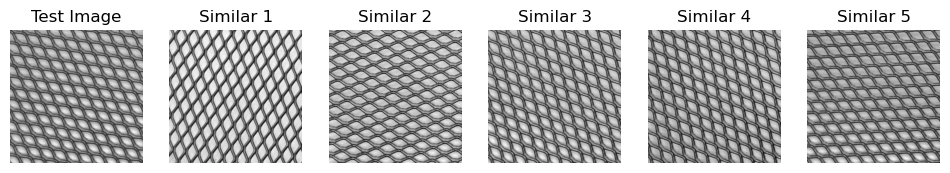


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/020.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/046.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/078.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/008.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png


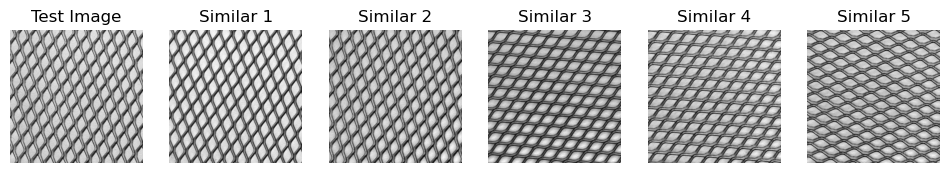


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/009.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/009.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/184.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/180.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/104.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/080.png


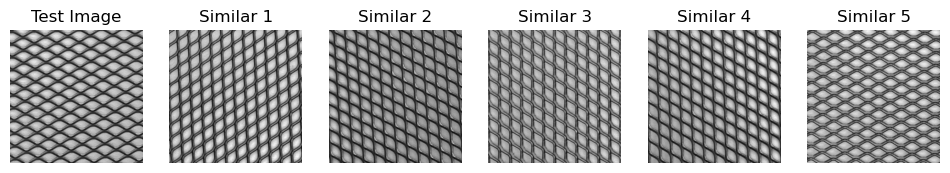


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/019.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/147.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/135.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/169.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/180.png


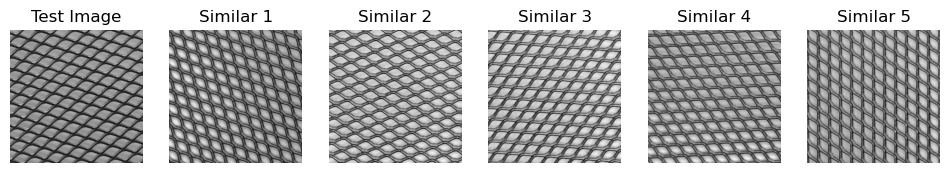


--------------------------------------------------

Test Image: /Users/namanlimani/Downloads/archive/grid/test/good/018.png
Top 5 similar images:
 - /Users/namanlimani/Downloads/archive/grid/train/good/253.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/134.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/119.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/133.png
 - /Users/namanlimani/Downloads/archive/grid/train/good/180.png


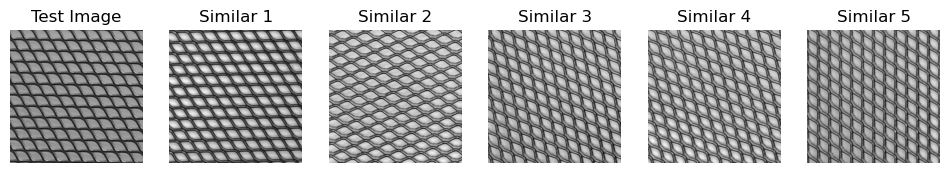


--------------------------------------------------



In [43]:
import os
import numpy as np
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

# Define dataset path
dataset_path = "/Users/namanlimani/Downloads/archive/grid"

def extract_features(images_path):
    features = []
    image_files = []
    for img_name in os.listdir(images_path):
        img_path = os.path.join(images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                img = Image.open(img_path).convert("L")
                img_resized = img.resize((64, 64))
                img_array = np.array(img_resized).flatten()
                features.append(img_array)
                image_files.append(img_path)
            except Exception as e:
                print(f"Error processing image {img_path}: {e}")
                continue
    return np.array(features), image_files

def find_similar_images_for_directory(test_images_path, features, image_files, top_n=5):
    test_results = {}
    for img_name in os.listdir(test_images_path):
        img_path = os.path.join(test_images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                input_image = Image.open(img_path).convert("L")
                input_image_resized = input_image.resize((64, 64))
                input_features = np.array(input_image_resized).flatten().reshape(1, -1)
                
                similarities = cosine_similarity(input_features, features).flatten()
                similar_indices = similarities.argsort()[-top_n:][::-1]
                
                similar_images = [image_files[i] for i in similar_indices]
                test_results[img_path] = similar_images
            except Exception as e:
                print(f"Error processing test image {img_path}: {e}")
                continue
    return test_results

def display_similar_images(test_results):
    if not test_results:
        print("No similar images found to display.")
        return
    
    for test_image, similar_images in test_results.items():
        # Print paths as shown in the screenshot for clarity
        print(f"Test Image: {test_image}")
        print("Top 5 similar images:")
        for img_path in similar_images:
            print(f" - {img_path}")
        
        # Display test and similar images in a row
        plt.figure(figsize=(12, 2))
        
        # Display the test image with label
        test_img = Image.open(test_image)
        plt.subplot(1, 6, 1)
        plt.imshow(test_img, cmap='gray')
        plt.axis('off')
        plt.title("Test Image")
        
        # Display each similar image with labels "Similar 1", "Similar 2", etc.
        for i, img_path in enumerate(similar_images):
            similar_img = Image.open(img_path)
            plt.subplot(1, 6, i + 2)
            plt.imshow(similar_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Similar {i+1}")
        
        plt.show()
        print("\n" + "-" * 50 + "\n")  # Separator for readability

# Load images and extract features from training data
train_images_path = os.path.join(dataset_path, "train/good")
features, image_files = extract_features(train_images_path)
print(f"Extracted features from {len(image_files)} training images.\n")

# Specify path to test images and display similar images
test_images_path = os.path.join(dataset_path, "test/good")
similar_images_results = find_similar_images_for_directory(test_images_path, features, image_files)
display_similar_images(similar_images_results)
